In [1]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from PIL import Image
import numpy as np
import requests
import datetime as dt


In [694]:
%matplotlib inline

In [575]:
import warnings
warnings.filterwarnings('ignore')

/Applications/anaconda3/lib/python3.8/site-packages/ipykernel/ipkernel.py:287: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


In [2]:
sns.reset_defaults()
sns.set(rc = {'figure.figsize': (7,5)}, style = 'white' )

In [3]:
pal = sns.color_palette("Set2")
pal

[(0.4, 0.7607843137254902, 0.6470588235294118),
 (0.9882352941176471, 0.5529411764705883, 0.3843137254901961),
 (0.5529411764705883, 0.6274509803921569, 0.796078431372549),
 (0.9058823529411765, 0.5411764705882353, 0.7647058823529411),
 (0.6509803921568628, 0.8470588235294118, 0.32941176470588235),
 (1.0, 0.8509803921568627, 0.1843137254901961),
 (0.8980392156862745, 0.7686274509803922, 0.5803921568627451),
 (0.7019607843137254, 0.7019607843137254, 0.7019607843137254)]

In [95]:
df = pd.read_csv('listings_Prague.csv')

In [5]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 7998 entries, 0 to 7997
Data columns (total 74 columns):
 #   Column                                        Non-Null Count  Dtype  
---  ------                                        --------------  -----  
 0   id                                            7998 non-null   int64  
 1   listing_url                                   7998 non-null   object 
 2   scrape_id                                     7998 non-null   int64  
 3   last_scraped                                  7998 non-null   object 
 4   name                                          7995 non-null   object 
 5   description                                   7886 non-null   object 
 6   neighborhood_overview                         5039 non-null   object 
 7   picture_url                                   7998 non-null   object 
 8   host_id                                       7998 non-null   int64  
 9   host_url                                      7998 non-null   o

# ID

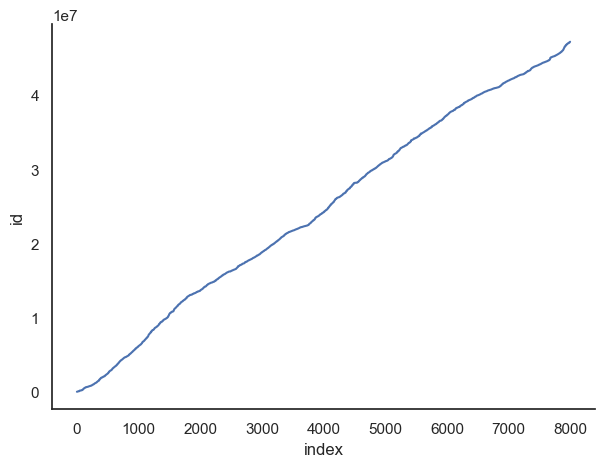

In [6]:
data = df['id'].to_frame().reset_index()

sns.lineplot(x = data['index'], y = data['id'])
sns.despine()
plt.show()

In [7]:
len(df['id'].unique())

7998

# Listing_url

In [8]:
print(df['listing_url'].head(20))
print(df[['id','first_review','last_review']].head(20))

0     https://www.airbnb.com/rooms/23163
1     https://www.airbnb.com/rooms/23169
2     https://www.airbnb.com/rooms/26748
3     https://www.airbnb.com/rooms/26755
4     https://www.airbnb.com/rooms/27916
5     https://www.airbnb.com/rooms/30762
6     https://www.airbnb.com/rooms/33813
7     https://www.airbnb.com/rooms/40726
8     https://www.airbnb.com/rooms/40728
9     https://www.airbnb.com/rooms/42514
10    https://www.airbnb.com/rooms/49874
11    https://www.airbnb.com/rooms/52148
12    https://www.airbnb.com/rooms/55361
13    https://www.airbnb.com/rooms/55844
14    https://www.airbnb.com/rooms/55856
15    https://www.airbnb.com/rooms/67612
16    https://www.airbnb.com/rooms/69335
17    https://www.airbnb.com/rooms/70003
18    https://www.airbnb.com/rooms/74283
19    https://www.airbnb.com/rooms/74999
Name: listing_url, dtype: object
       id first_review last_review
0   23163   2010-09-20  2020-08-22
1   23169   2012-12-24  2020-12-17
2   26748   2010-09-21  2020-09-29
3   267

In [9]:
print(df['listing_url'].tail(20))
print(df[['id','first_review','last_review']].tail(20))

7978    https://www.airbnb.com/rooms/47016050
7979    https://www.airbnb.com/rooms/47016599
7980    https://www.airbnb.com/rooms/47017403
7981    https://www.airbnb.com/rooms/47017948
7982    https://www.airbnb.com/rooms/47018563
7983    https://www.airbnb.com/rooms/47019532
7984    https://www.airbnb.com/rooms/47041824
7985    https://www.airbnb.com/rooms/47045290
7986    https://www.airbnb.com/rooms/47054898
7987    https://www.airbnb.com/rooms/47070261
7988    https://www.airbnb.com/rooms/47070340
7989    https://www.airbnb.com/rooms/47078508
7990    https://www.airbnb.com/rooms/47089032
7991    https://www.airbnb.com/rooms/47109880
7992    https://www.airbnb.com/rooms/47110521
7993    https://www.airbnb.com/rooms/47127221
7994    https://www.airbnb.com/rooms/47143613
7995    https://www.airbnb.com/rooms/47151609
7996    https://www.airbnb.com/rooms/47157526
7997    https://www.airbnb.com/rooms/47160252
Name: listing_url, dtype: object
            id first_review last_review
7978  4

# scrape_id, last_scraped

In [10]:
df.iloc[1000:1010,2:4]

,scrape_id,last_scraped
1000,20201221134014,2020-12-21
1001,20201221134014,2020-12-22
1002,20201221134014,2020-12-22
1003,20201221134014,2020-12-21
1004,20201221134014,2020-12-22
1005,20201221134014,2020-12-21
1006,20201221134014,2020-12-21
1007,20201221134014,2020-12-21
1008,20201221134014,2020-12-21
1009,20201221134014,2020-12-21


# name, description, neighborhood_overview

In [11]:
df.iloc[1000:1010,4:7]

,name,description,neighborhood_overview
1000,ROYAL COURT APARTMENTS IN ⭐️PRAGUE⭐️,1 – Room apartment<br />RECEPTION WORKS NONSTO...,In this central and at the same time lovely di...
1001,Útulný byt s výhledem do zahrady blízko centra,"Byt není velký, jen 60m2. Potraviny a nápoje ...",15 min chůze od apartmantu se nachází výstavní...
1002,Nice family house in Prague (2),Our house is between the city center and the a...,Our neighboorhhod is perfect because it is ver...
1003,"Central, Walkable, Luxury, Near Tram/Metro, Wifi",SEE ALL OUR APARTMENTS<br />https://www.airbnb...,• We are located in the heart of the UNESCO pr...
1004,Nice family house in Prague (3),Our house is between the city center and the a...,Our neighboorhhod is perfect because it is ver...
1005,Modern flat in historic.building-wider city ce...,Very modern flat in an excellent location. Ver...,Quiet neighbourhood yet everything is in very ...
1006,Queen Bee house. Johan studio,Lovely studio in UNESCO heritage baroque build...,The quarter is called Lesser Town and is older...
1007,Kampa Park - stunning apartment.,"This fabulous , large 1 bedroomed apartment w...","Take a morning stroll through Kampa park, pick..."
1008,Queen Bee house. Mathilda apartment,Lovely apartment in UNESCO heritage baroque bu...,The quarter is called Lesser Town and is older...
1009,Queen Bee house. Victor studio,Lovely studio in UNESCO heritage baroque buil...,The quarter is called Lesser Town and is older...


# picture_url

In [12]:
from io import BytesIO

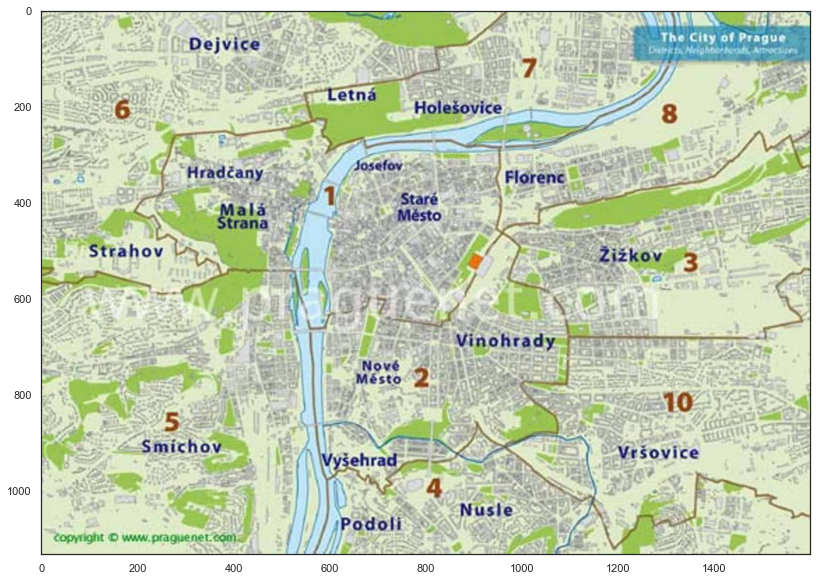

In [977]:
show_pict('https://bezviz.info/images/czech/life/prague-districts.jpg')

In [976]:
def show_pict(url):
    fig = plt.figure(figsize=(20,10))
    r = requests.get(url)
    pil_im = Image.open(BytesIO(r.content))
    im_array = np.asarray(pil_im)
    plt.imshow(im_array)
    plt.show()

In [14]:
top_5 = df.sort_values(by = ['review_scores_rating'], ascending = False)[df['number_of_reviews']>400][['review_scores_rating','number_of_reviews']].head(5)
bottom_5 = df.sort_values(by = ['review_scores_rating'], ascending = False)[df['number_of_reviews']>50][['review_scores_rating','number_of_reviews']].tail(5)

<ipython-input-14-75c86064ffd2>:1: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  top_5 = df.sort_values(by = ['review_scores_rating'], ascending = False)[df['number_of_reviews']>400][['review_scores_rating','number_of_reviews']].head(5)
<ipython-input-14-75c86064ffd2>:2: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  bottom_5 = df.sort_values(by = ['review_scores_rating'], ascending = False)[df['number_of_reviews']>50][['review_scores_rating','number_of_reviews']].tail(5)


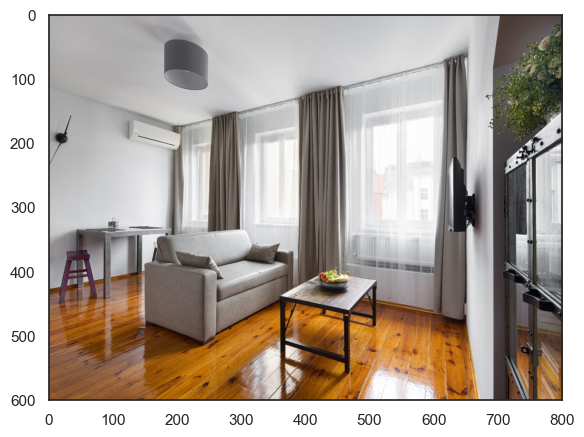

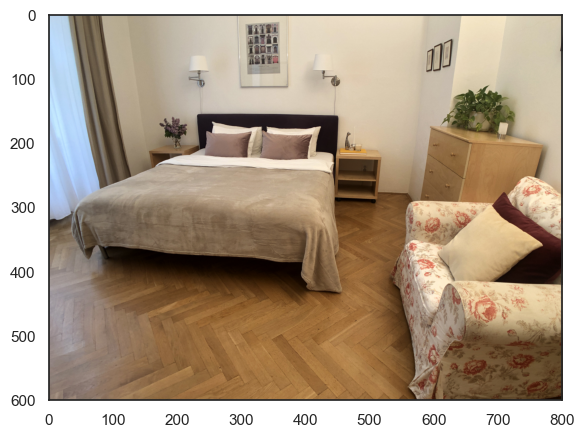

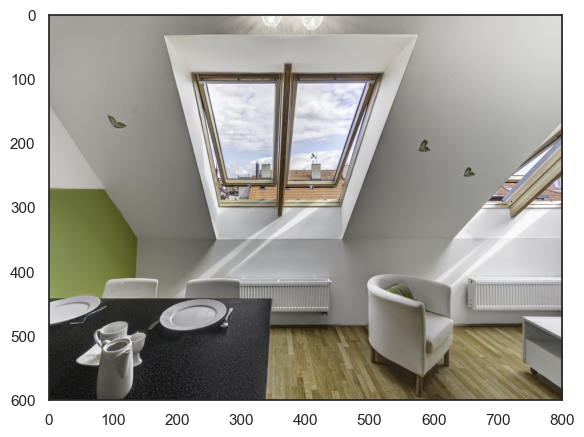

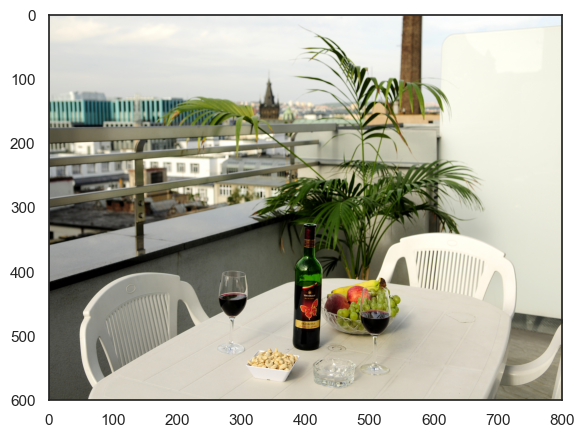

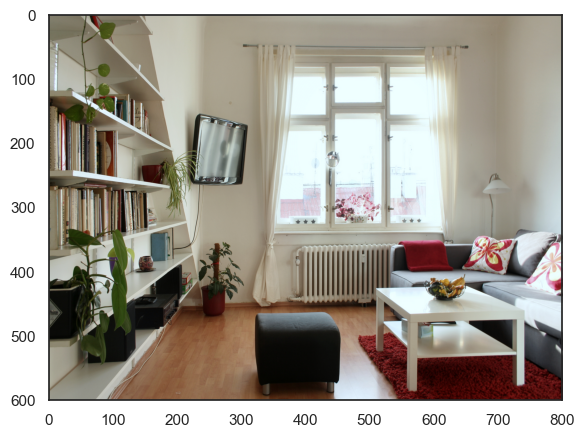

In [15]:
#top_5
for i in df['picture_url'].reindex(top_5.index):
    show_pict(i)

In [16]:
df['listing_url'].reindex(top_5.index)

715      https://www.airbnb.com/rooms/4255713
368      https://www.airbnb.com/rooms/1686130
350      https://www.airbnb.com/rooms/1498761
4491    https://www.airbnb.com/rooms/28100352
332      https://www.airbnb.com/rooms/1394492
Name: listing_url, dtype: object

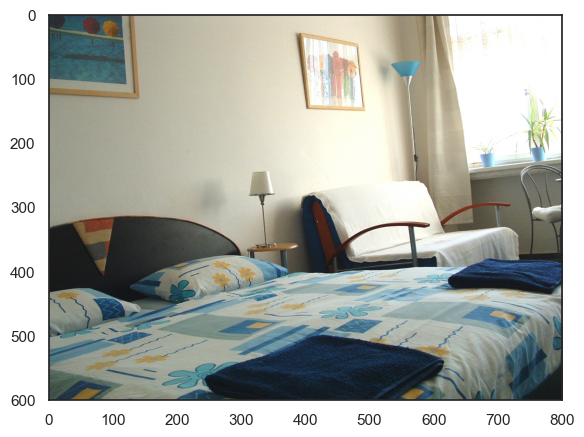

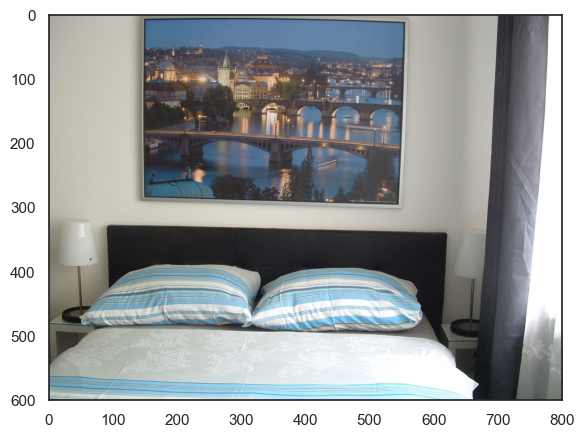

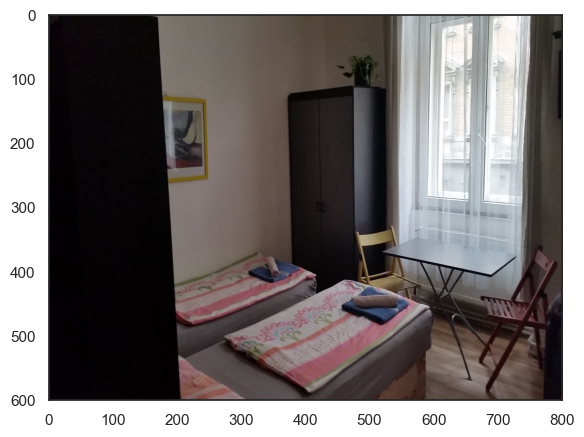

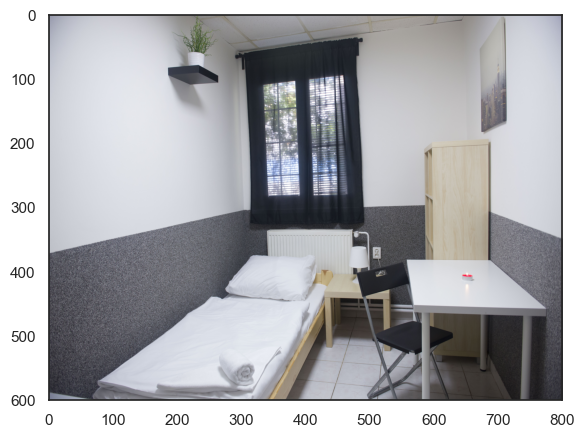

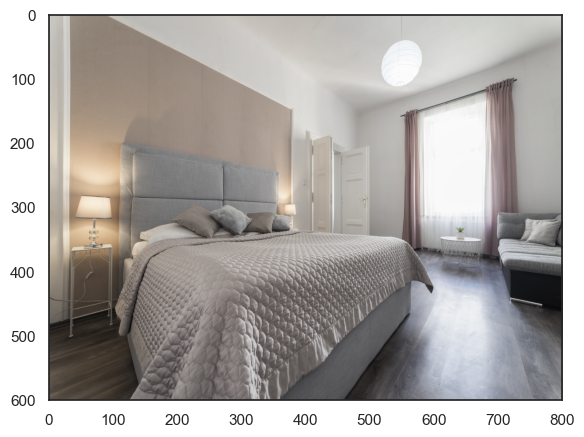

In [17]:
#bottom_5

for i in df['picture_url'].reindex(bottom_5.index):
    show_pict(i)
plt.show()

In [18]:
df['listing_url'].reindex(bottom_5.index)

50        https://www.airbnb.com/rooms/181951
84        https://www.airbnb.com/rooms/254416
79        https://www.airbnb.com/rooms/222299
2191    https://www.airbnb.com/rooms/14738087
6720    https://www.airbnb.com/rooms/40730839
Name: listing_url, dtype: object

# 'host_id', 'host_url',
# 'host_name', 'host_since', 'host_location', 'host_about',
# 'host_response_time', 'host_response_rate', 'host_acceptance_rate',
# 'host_is_superhost', 'host_thumbnail_url', 'host_picture_url',
# 'host_neighbourhood', 'host_listings_count',
# 'host_total_listings_count', 'host_verifications',
# 'host_has_profile_pic', 'host_identity_verified',

In [19]:
df[['host_id', 'host_url','host_name', 'host_since', 'host_location', 'host_about','host_response_time', 'host_response_rate', 'host_acceptance_rate','host_is_superhost', 'host_thumbnail_url', 'host_picture_url','host_neighbourhood', 'host_listings_count','host_total_listings_count', 'host_verifications','host_has_profile_pic', 'host_identity_verified']].iloc[0]

host_id                                                                   5282
host_url                                https://www.airbnb.com/users/show/5282
host_name                                                                Klara
host_since                                                          2008-12-17
host_location                                   Prague, Prague, Czech Republic
host_about                   Hello, \r\nglad to see that you are interested...
host_response_time                                              within an hour
host_response_rate                                                        100%
host_acceptance_rate                                                       98%
host_is_superhost                                                            f
host_thumbnail_url           https://a0.muscache.com/im/pictures/user/b7309...
host_picture_url             https://a0.muscache.com/im/pictures/user/b7309...
host_neighbourhood                                  

In [20]:
data = df[['host_since','host_response_time', 'host_response_rate', 'host_acceptance_rate','host_is_superhost','host_total_listings_count']]
data

,host_since,host_response_time,host_response_rate,host_acceptance_rate,host_is_superhost,host_total_listings_count
0,2008-12-17,within an hour,100%,98%,f,68.0
1,2008-12-17,within an hour,100%,98%,f,68.0
2,2010-04-26,within an hour,100%,100%,t,3.0
3,2010-04-26,within an hour,100%,100%,t,3.0
4,2010-05-08,within an hour,100%,99%,t,3.0
...,...,...,...,...,...,...
7993,2017-06-24,NaN,NaN,NaN,f,1.0
7994,2020-12-16,NaN,NaN,100%,f,1.0
7995,2016-02-20,within an hour,100%,100%,f,28.0
7996,2020-12-20,NaN,NaN,NaN,f,0.0


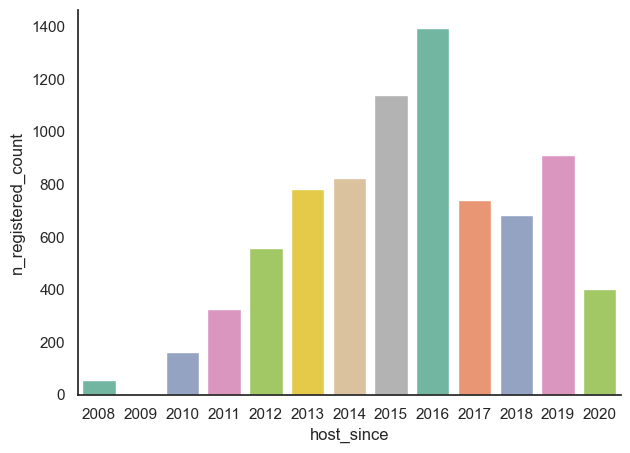

In [21]:
data = pd.to_datetime(df['host_since'],format='%Y-%m-%d')
data = data.apply(lambda x: x.year).to_frame()
data = data.value_counts().sort_index()
data.name = 'n_registered_count'
data = data.to_frame().reset_index().astype(int)

sns.barplot(x = 'host_since', y = 'n_registered_count', data = data, palette = pal)
sns.despine()
plt.show()

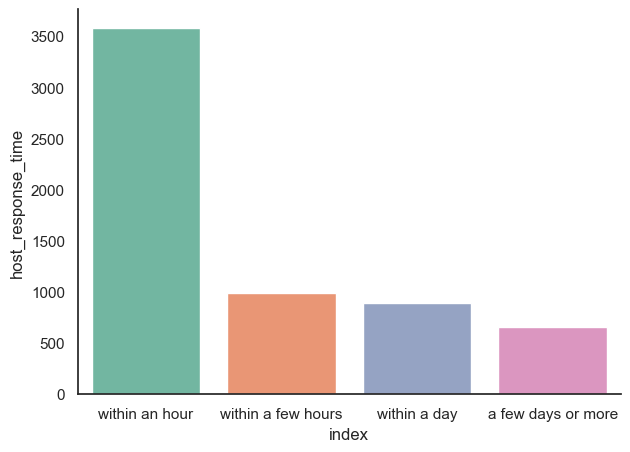

In [22]:
data = df['host_response_time'].value_counts().to_frame().reset_index()
sns.barplot(x = 'index', y = 'host_response_time', data = data, palette = pal)
sns.despine()
plt.show()

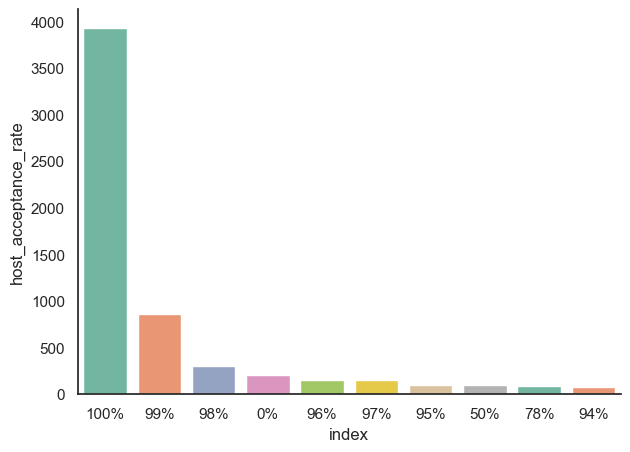

In [23]:
data = df['host_acceptance_rate'].value_counts().to_frame().reset_index().head(10)
sns.barplot(x = 'index', y = 'host_acceptance_rate', data = data, palette = pal)
sns.despine()
plt.show()

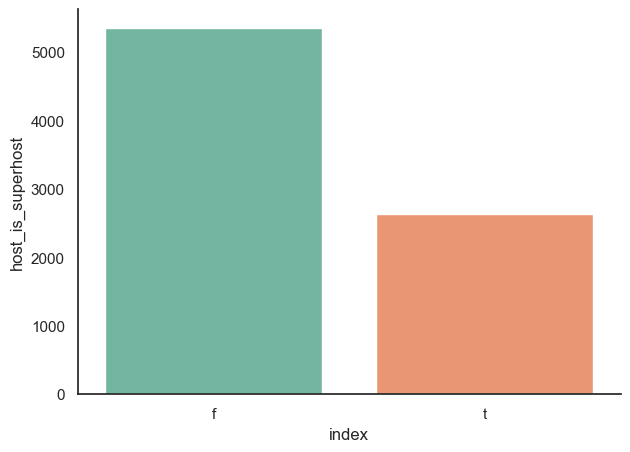

In [24]:
data = df['host_is_superhost'].value_counts().to_frame().reset_index()
sns.barplot(x = 'index', y = 'host_is_superhost', data = data, palette = pal)
sns.despine()
plt.show()

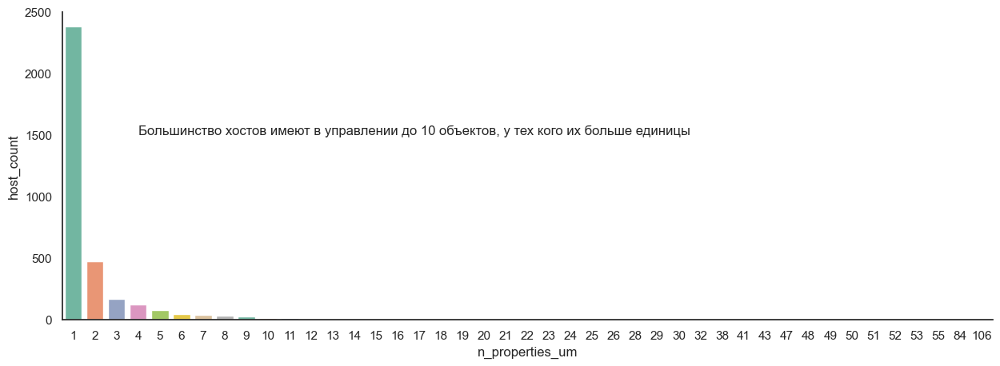

In [25]:
data = df['host_id'].value_counts().to_frame()
data = data.value_counts().reset_index().rename(columns = {'host_id':'n_properties_um',0:'host_count'})
fig,ax = plt.subplots(figsize=(15,5))
sns.barplot(x = 'n_properties_um', y = 'host_count', data = data, ax = ax, palette = pal)
_ = ax.text(3, 1500, 'Большинство хостов имеют в управлении до 10 объектов, у тех кого их больше единицы')
sns.despine()
plt.show()

# 'neighbourhood',
  #     'neighbourhood_cleansed', 'neighbourhood_group_cleansed'

In [26]:
df[['neighbourhood',
       'neighbourhood_cleansed', 'neighbourhood_group_cleansed']]

,neighbourhood,neighbourhood_cleansed,neighbourhood_group_cleansed
0,"Prague, Czech Republic, Czechia",Praha 1,NaN
1,"Prague, Czech Republic, Czechia",Praha 1,NaN
2,"Prague, Hlavní město Praha, Czechia",Praha 7,NaN
3,"Prague, Hlavní město Praha, Czechia",Praha 1,NaN
4,"Prague, Czechia",Praha 3,NaN
...,...,...,...
7993,NaN,Praha 17,NaN
7994,NaN,Praha 1,NaN
7995,NaN,Praha 5,NaN
7996,NaN,Praha 1,NaN


In [27]:
data = df[['neighbourhood_cleansed']]
fig,ax = plt.subplots(figsize=(15,5))
sns.histplot(data, x = 'neighbourhood_cleansed', binrange = (0,10))
sns.despine()

# 'latitude',
  #     'longitude'

# 'property_type', 'room_type', 'accommodates', 'bathrooms',
  #     'bathrooms_text', 'bedrooms', 'beds', 'amenities'

In [28]:
data = df[['property_type', 'room_type', 'accommodates', 'bathrooms',
       'bathrooms_text', 'bedrooms', 'beds', 'amenities']]
data

,property_type,room_type,accommodates,bathrooms,bathrooms_text,bedrooms,beds,amenities
0,Entire apartment,Entire home/apt,4,NaN,1 bath,1.0,2.0,"[""Coffee maker"", ""Dryer"", ""Elevator"", ""Hair dr..."
1,Entire apartment,Entire home/apt,4,NaN,1 bath,1.0,2.0,"[""Coffee maker"", ""Dryer"", ""Elevator"", ""Hair dr..."
2,Entire apartment,Entire home/apt,6,NaN,1 bath,2.0,2.0,"[""Fire extinguisher"", ""First aid kit"", ""Coffee..."
3,Entire apartment,Entire home/apt,4,NaN,1.5 baths,1.0,2.0,"[""Fire extinguisher"", ""First aid kit"", ""Coffee..."
4,Entire condominium,Entire home/apt,2,NaN,1 bath,NaN,1.0,"[""Paid parking off premises"", ""Elevator"", ""Hai..."
...,...,...,...,...,...,...,...,...
7993,Private room in condominium,Private room,2,NaN,1 private bath,NaN,1.0,"[""Clothing storage"", ""Baking sheet"", ""Shower g..."
7994,Entire apartment,Entire home/apt,6,NaN,1 bath,NaN,1.0,"[""Dryer"", ""Dedicated workspace"", ""Hair dryer"",..."
7995,Entire serviced apartment,Entire home/apt,9,NaN,1 bath,2.0,4.0,"[""Fire extinguisher"", ""Paid parking off premis..."
7996,Entire apartment,Entire home/apt,6,NaN,1 bath,NaN,1.0,"[""Dryer"", ""Dedicated workspace"", ""First aid ki..."


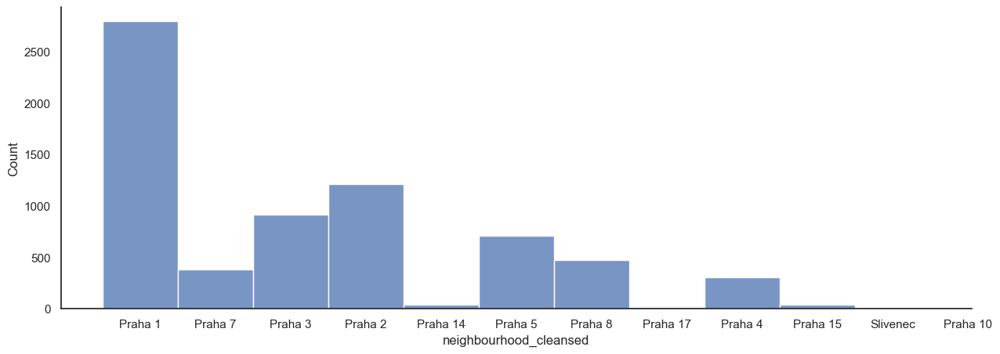

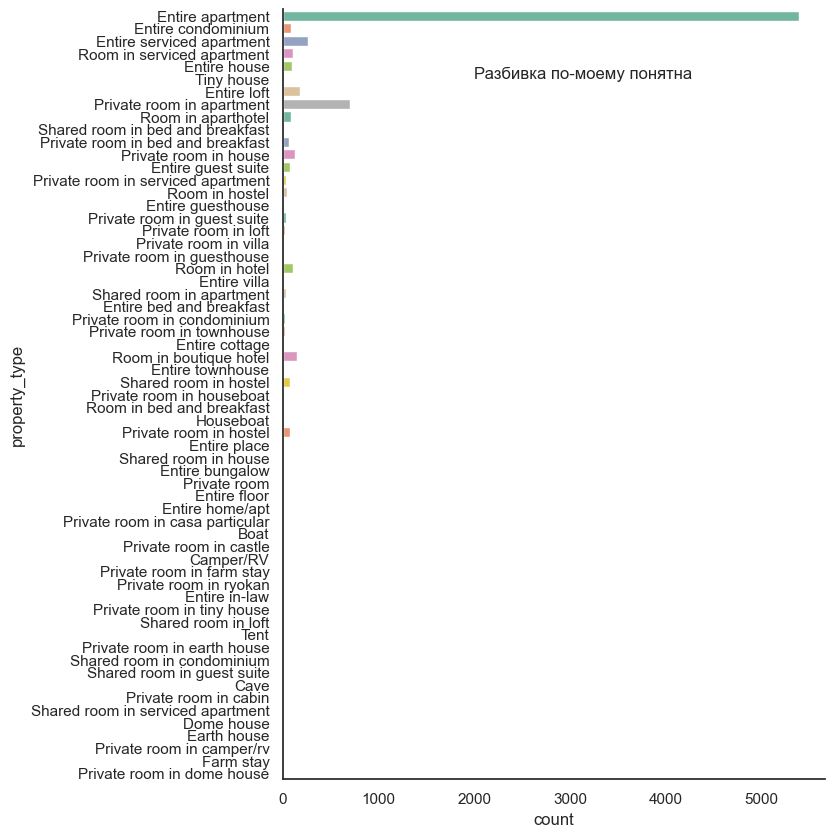

In [29]:
fig, ax = plt.subplots(figsize=(7, 10))
f = df['property_type'].to_frame()
_ = sns.countplot(y='property_type', data=f, palette = pal)
_ = ax.text(2000, 5, 'Разбивка по-моему понятна')
sns.despine()
plt.show()

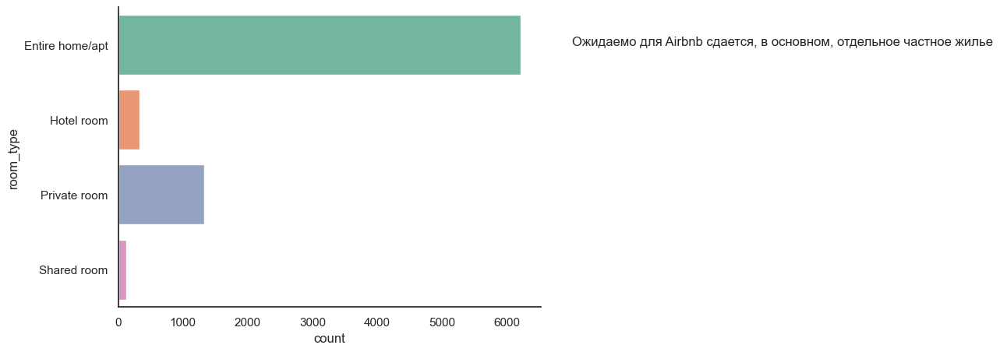

In [30]:
#fig, ax = plt.subplots(figsize=(7, 10))
f = df['room_type'].to_frame()
ax = sns.countplot(y='room_type', data=f, palette = pal)
_ = ax.text(7000, 0, 'Ожидаемо для Airbnb сдается, в основном, отдельное частное жилье')
sns.despine()
plt.show()

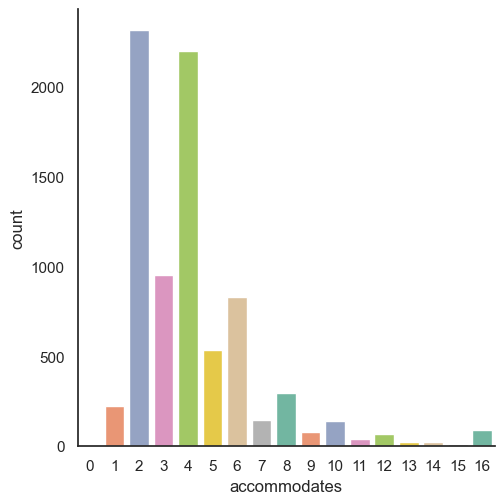

In [31]:
data = df['accommodates'].to_frame()
_ = sns.catplot(x="accommodates", kind="count", data=data, palette = pal)
plt.show()

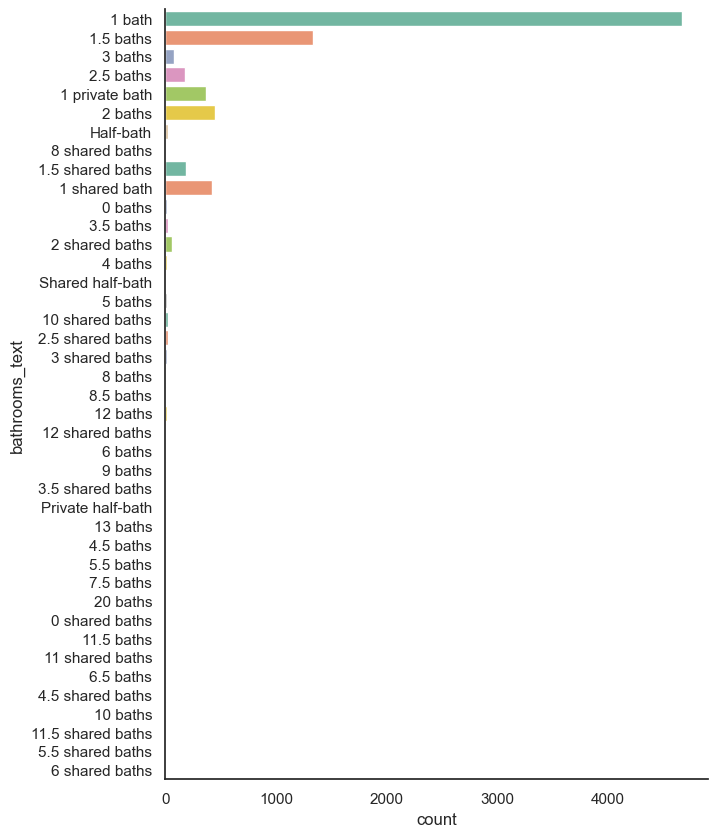

In [32]:
fig, ax = plt.subplots(figsize=(7, 10))
data = df['bathrooms_text'].to_frame()
_ = sns.countplot(y='bathrooms_text', data = data, palette = pal)
sns.despine()
plt.show()

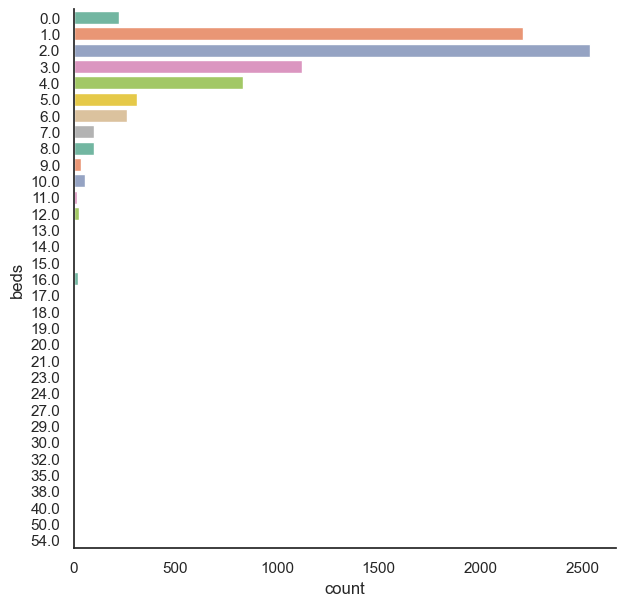

In [33]:
fig, ax = plt.subplots(figsize=(7, 7))
data = df['beds'].to_frame()
_ = sns.countplot(y='beds', data = data, palette = pal)
sns.despine()
plt.show()

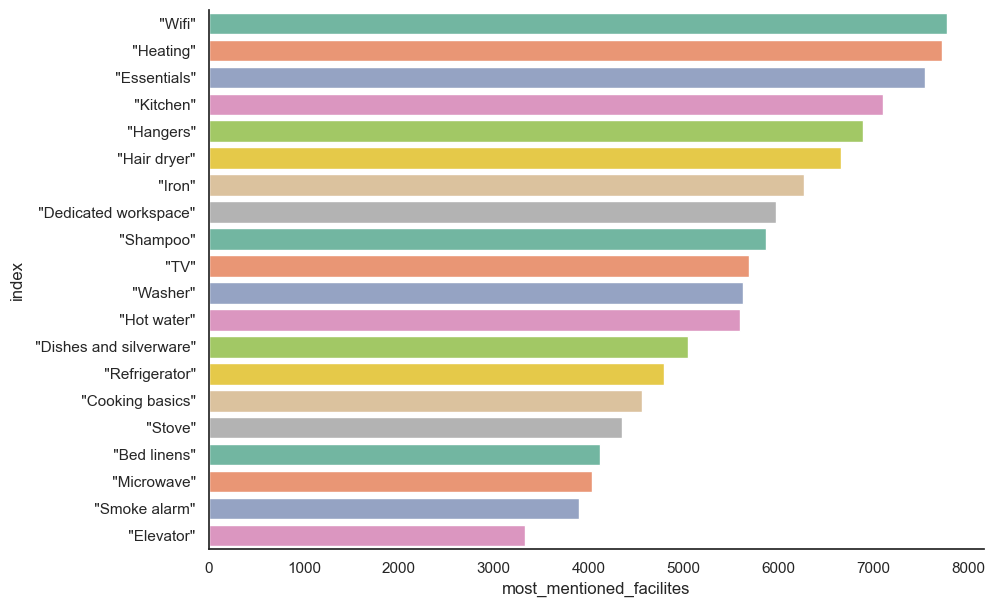

In [34]:
max_value = int(df['amenities'].apply(lambda x: len(x.split(','))).to_frame().max())
data = df['amenities'].str.split(',', max_value, expand=True)
data = data.applymap(lambda x: x.rstrip(']').lstrip('['), na_action = 'ignore')
data = pd.value_counts(data.values.ravel()).head(20)
data.name = 'most_mentioned_facilites'
data = data.to_frame().reset_index()

fig, ax = plt.subplots(figsize=(10, 7))
_ = sns.barplot(x = 'most_mentioned_facilites', y='index', data = data, palette = pal, orient = 'h')
sns.despine()
plt.show()

# 'price'

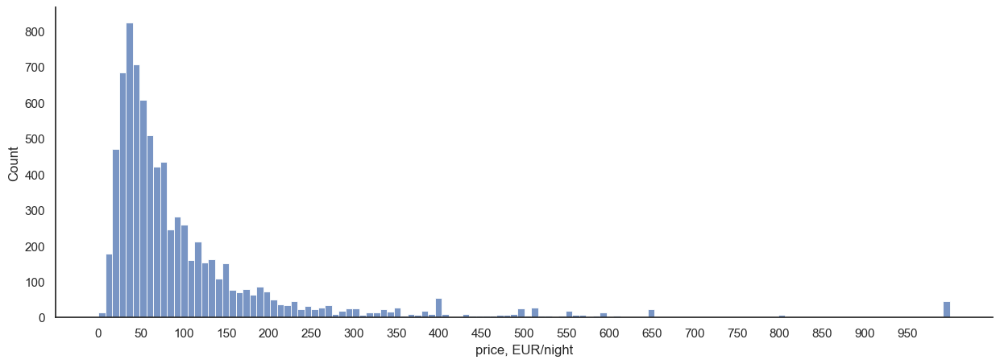

In [35]:
data = df['price'].str.strip('$').str.replace(',','')
data.name = 'price, EUR/night'
data = pd.to_numeric(data,downcast = 'signed').to_frame()
data = data*0.038 # перевел в EUR
fig,ax = plt.subplots(figsize=(15,5))
ax = sns.histplot(data, x = 'price, EUR/night', binrange = (0,1000), palette = pal)
ax.set_xticks([i for i in range(0,1000,50)])
sns.despine()
plt.show()

# 'minimum_nights', 'maximum_nights', 'minimum_minimum_nights',
 #      'maximum_minimum_nights', 'minimum_maximum_nights',
  #     'maximum_maximum_nights', 'minimum_nights_avg_ntm',
   #    'maximum_nights_avg_ntm'

In [36]:
df[['minimum_nights', 'maximum_nights', 'minimum_minimum_nights',
       'maximum_minimum_nights', 'minimum_maximum_nights',
       'maximum_maximum_nights', 'minimum_nights_avg_ntm',
       'maximum_nights_avg_ntm']]

,minimum_nights,maximum_nights,minimum_minimum_nights,maximum_minimum_nights,minimum_maximum_nights,maximum_maximum_nights,minimum_nights_avg_ntm,maximum_nights_avg_ntm
0,1,365,1,7,365,365,2.3,365.0
1,1,365,1,4,365,365,1.1,365.0
2,3,365,3,7,1125,1125,3.2,1125.0
3,3,700,3,7,1125,1125,3.2,1125.0
4,2,21,2,2,1125,1125,2.0,1125.0
...,...,...,...,...,...,...,...,...
7993,1,365,1,1,1125,1125,1.0,1125.0
7994,3,1125,3,3,1125,1125,3.0,1125.0
7995,7,1125,7,7,1125,1125,7.0,1125.0
7996,3,1125,3,3,1125,1125,3.0,1125.0


# 'calendar_updated', 'has_availability',
  #     'availability_30', 'availability_60', 'availability_90',
   #    'availability_365', 'calendar_last_scraped',

In [37]:
df[['calendar_updated', 'has_availability',
       'availability_30', 'availability_60', 'availability_90',
       'availability_365', 'calendar_last_scraped',]]

,calendar_updated,has_availability,availability_30,availability_60,availability_90,availability_365,calendar_last_scraped
0,NaN,t,30,60,90,91,2020-12-21
1,NaN,t,0,0,0,0,2020-12-22
2,NaN,t,0,0,0,185,2020-12-22
3,NaN,t,30,60,90,365,2020-12-22
4,NaN,t,30,60,90,180,2020-12-22
...,...,...,...,...,...,...,...
7993,NaN,t,10,40,70,160,2020-12-22
7994,NaN,t,0,0,0,0,2020-12-22
7995,NaN,t,0,0,0,0,2020-12-22
7996,NaN,t,24,54,84,84,2020-12-21


In [38]:
df['has_availability'].value_counts()

t    7983
f      15
Name: has_availability, dtype: int64

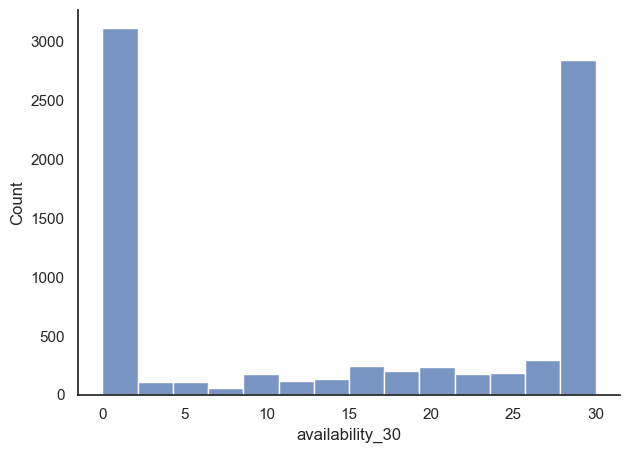

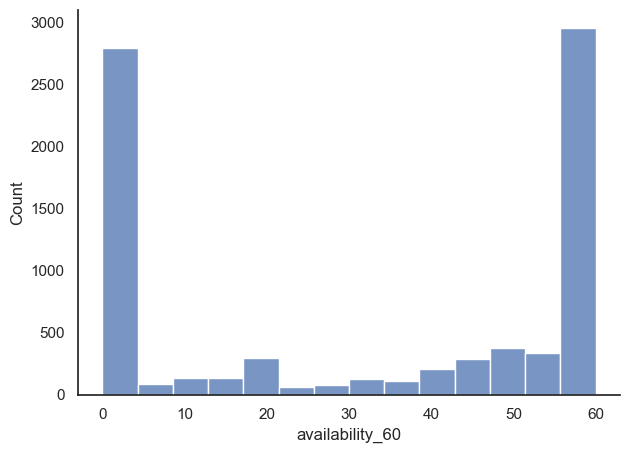

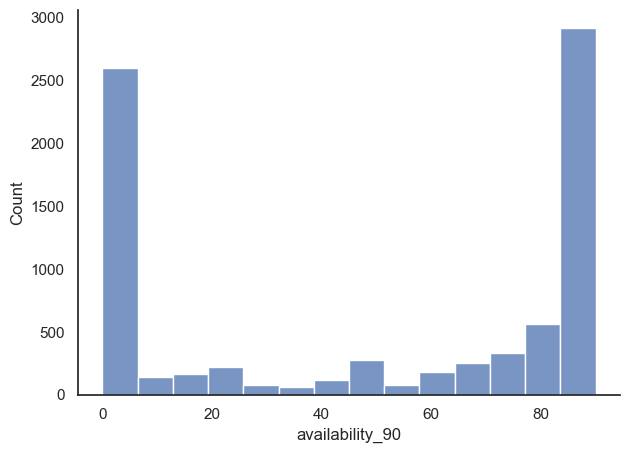

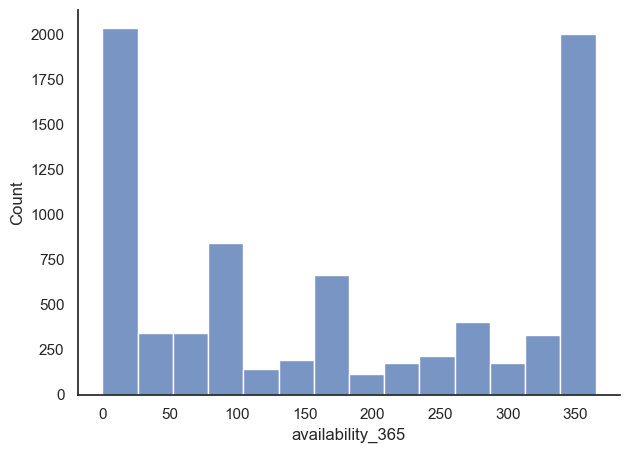

In [39]:
columns = ['availability_30', 'availability_60', 'availability_90',
       'availability_365']

#fig,ax = plt.subplots(figsize=(5,5))

for c in columns:
    data = df[c].to_frame()
    sns.histplot(data, x = c, binrange = (0,df[c].max()))
#    ax.set_xticks([i for i in range(0,df[c].max(),2)])
    sns.despine()
    plt.show()

In [40]:
df_h = df['availability_60']
df_h[(df_h>1)&(df_h<59)]

5        8
6       47
14      52
15      43
19      29
        ..
7989    47
7991    23
7993    40
7996    54
7997    57
Name: availability_60, Length: 2861, dtype: int64

# 'number_of_reviews',
  #     'number_of_reviews_ltm', 'number_of_reviews_l30d', 'first_review',
   #    'last_review', 'review_scores_rating', 'review_scores_accuracy',
   #   'review_scores_cleanliness', 'review_scores_checkin',
   #  'review_scores_communication', 'review_scores_location',
   # 'review_scores_value','reviews_per_month'

In [41]:
df[['number_of_reviews',
'number_of_reviews_ltm', 'number_of_reviews_l30d', 'first_review',
'last_review', 'review_scores_rating', 'review_scores_accuracy',
'review_scores_cleanliness', 'review_scores_checkin',
'review_scores_communication', 'review_scores_location',
'review_scores_value','reviews_per_month']]

,number_of_reviews,number_of_reviews_ltm,number_of_reviews_l30d,first_review,last_review,review_scores_rating,review_scores_accuracy,review_scores_cleanliness,review_scores_checkin,review_scores_communication,review_scores_location,review_scores_value,reviews_per_month
0,20,1,0,2010-09-20,2020-08-22,98.0,9.0,10.0,10.0,10.0,10.0,10.0,0.16
1,90,2,1,2012-12-24,2020-12-17,95.0,9.0,10.0,10.0,10.0,10.0,9.0,0.92
2,357,14,0,2010-09-21,2020-09-29,97.0,10.0,10.0,10.0,10.0,10.0,10.0,2.86
3,253,14,1,2015-05-19,2020-11-27,99.0,10.0,10.0,10.0,10.0,10.0,10.0,3.71
4,413,11,0,2010-07-27,2020-03-11,96.0,10.0,10.0,10.0,10.0,10.0,10.0,3.26
...,...,...,...,...,...,...,...,...,...,...,...,...,...
7993,0,0,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
7994,0,0,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
7995,0,0,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
7996,0,0,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


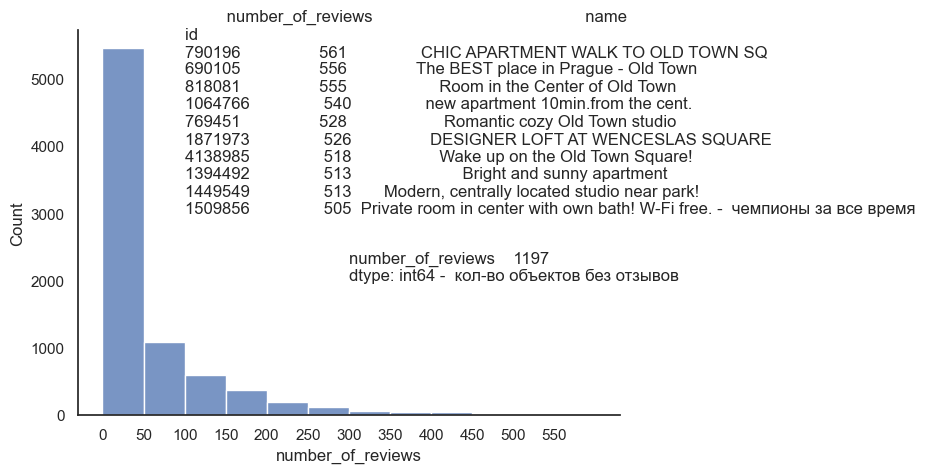

In [42]:
data = df['number_of_reviews']
data = data.to_frame()
data = data.sort_values(by = 'number_of_reviews',ascending = False)
ax = sns.histplot(data, x = 'number_of_reviews', binwidth = 50,palette = pal )
ax.set_xticks([i for i in range(0,int(data.max()),50)])
chs = data.head(10)
chs = df.reindex(chs.index)[['id','number_of_reviews','name']].set_index('id')
text = str(data[data['number_of_reviews'] == 0].count()) + ' -  кол-во объектов без отзывов'
text2 = str(chs) + ' -  чемпионы за все время'
_ = ax.text(300, 2000, text)
_ = ax.text(100, 3000, text2)
sns.despine()
plt.show()

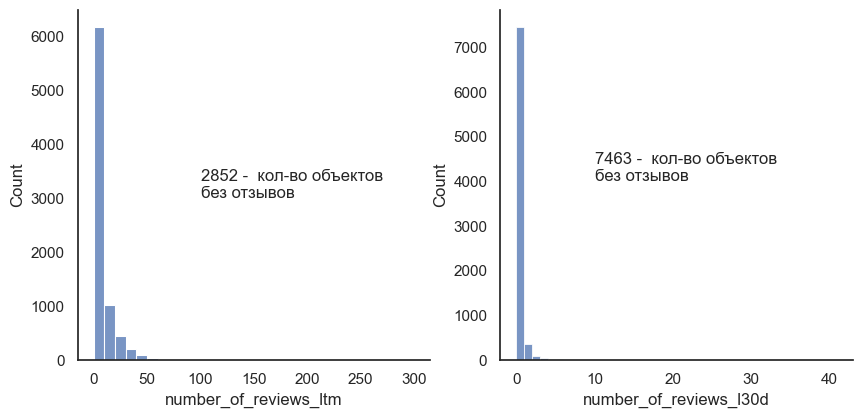

In [43]:
data = df['number_of_reviews_ltm'].to_frame()
data2 = df['number_of_reviews_l30d'].to_frame()


text1 = str(int(data[data['number_of_reviews_ltm'] == 0].count())) + ' -  кол-во объектов\nбез отзывов'
text2 = str(int(data2[data2['number_of_reviews_l30d'] == 0].count())) + ' -  кол-во объектов\nбез отзывов'


fig = plt.figure(figsize=(10,10))
ax1 = fig.add_subplot(2,2,1)
_ = ax1.text(100, 3000, text1)
sns.histplot(data, x = 'number_of_reviews_ltm', binwidth = 10,palette = pal,ax = ax1)

ax2 = fig.add_subplot(2,2,2)
_ = ax2.text(10, 4000, text2)
sns.histplot(data2, x = 'number_of_reviews_l30d', binwidth = 1,palette = pal,ax = ax2, )
sns.despine()
plt.show()

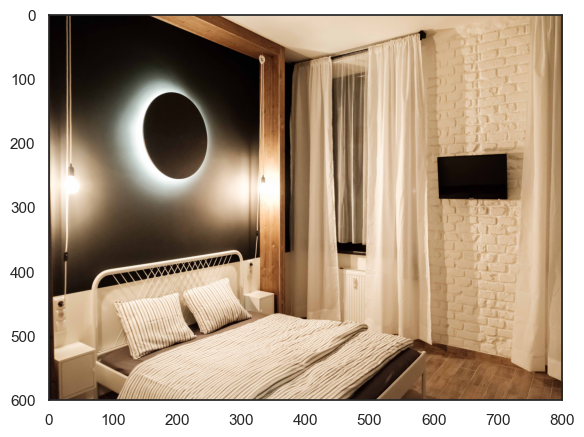

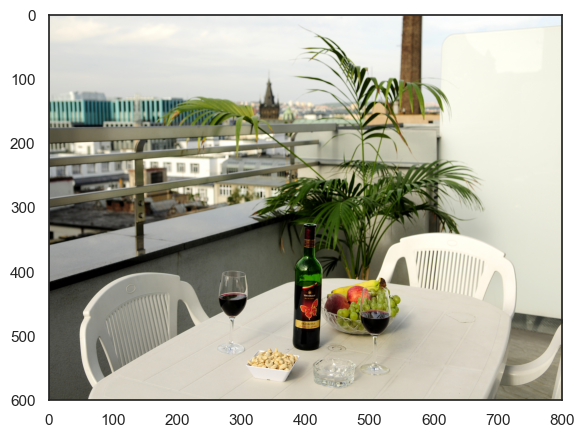

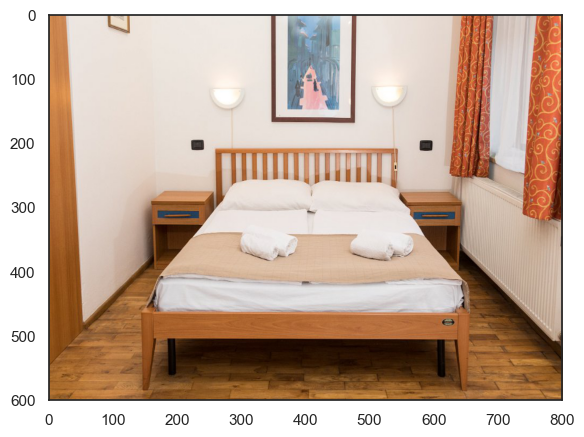

In [44]:
df_h = df.reindex(data[data['number_of_reviews_ltm']>100].index)
for i in df_h['picture_url']:
    show_pict(i)

In [45]:
df[['neighbourhood_cleansed','price','number_of_reviews','number_of_reviews_ltm','number_of_reviews_l30d']].reindex(df_h.index)

,neighbourhood_cleansed,price,number_of_reviews,number_of_reviews_ltm,number_of_reviews_l30d
3151,Praha 5,$586.00,305,295,41
4491,Praha 1,"$4,167.00",478,281,3
5090,Praha 8,"$6,988.00",161,111,0


In [46]:
df['listing_url'].reindex(df_h.index)

3151    https://www.airbnb.com/rooms/19748903
4491    https://www.airbnb.com/rooms/28100352
5090    https://www.airbnb.com/rooms/31482358
Name: listing_url, dtype: object

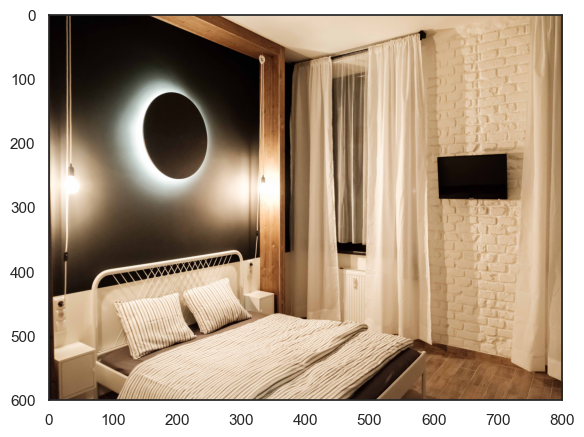

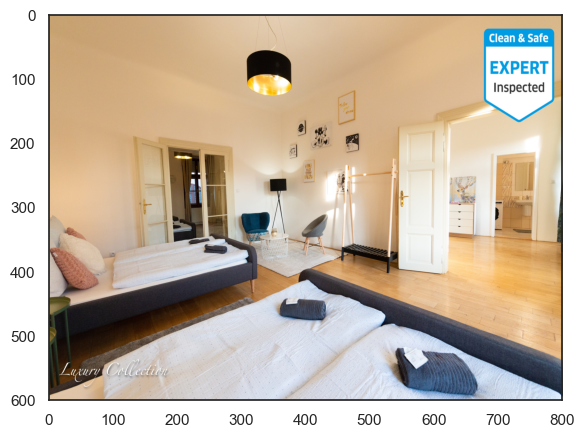

In [47]:
df_h = df.reindex(data2[data2['number_of_reviews_l30d']>10].index)
for i in df_h['picture_url']:
    show_pict(i)

In [48]:
df[['neighbourhood_cleansed','price','number_of_reviews','number_of_reviews_ltm','number_of_reviews_l30d']].reindex(df_h.index)

,neighbourhood_cleansed,price,number_of_reviews,number_of_reviews_ltm,number_of_reviews_l30d
3151,Praha 5,$586.00,305,295,41
6548,Praha 1,"$1,310.00",86,76,11


In [49]:
df['listing_url'].reindex(df_h.index)

3151    https://www.airbnb.com/rooms/19748903
6548    https://www.airbnb.com/rooms/40134614
Name: listing_url, dtype: object

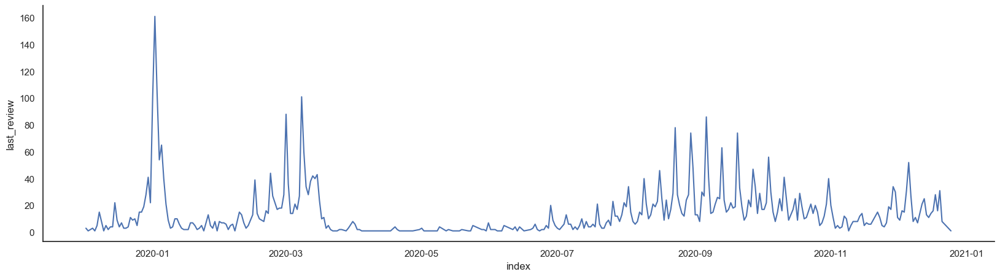

In [50]:
data = df['last_review'].value_counts().sort_index().reset_index()
data['index'] = pd.to_datetime(data['index'],format='%Y-%m-%d').apply(lambda x: x.date())
data = data[data['index'] > dt.date(2019,12,1)]


fig = plt.figure(figsize=(20,5))
sns.lineplot(x = 'index', y = 'last_review', data = data, palette = pal)
sns.despine()
plt.show()

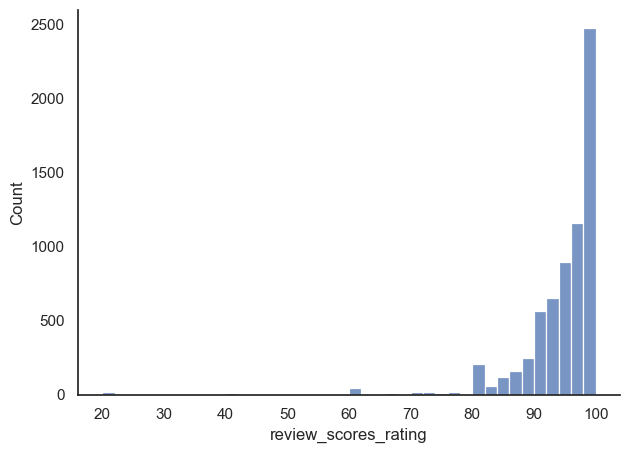

In [51]:
data = (df['review_scores_rating']).to_frame()

sns.histplot(data, x = 'review_scores_rating',palette = pal, binwidth = 2)
sns.despine()
plt.show()

# 'license', 'instant_bookable',
  #     'calculated_host_listings_count',
   #    'calculated_host_listings_count_entire_homes',
  #  'calculated_host_listings_count_private_rooms',
   #  'calculated_host_listings_count_shared_rooms', 'reviews_per_month'

In [52]:
df[['license', 'instant_bookable',
       'calculated_host_listings_count',
       'calculated_host_listings_count_entire_homes',
       'calculated_host_listings_count_private_rooms',
       'calculated_host_listings_count_shared_rooms']]

,license,instant_bookable,calculated_host_listings_count,calculated_host_listings_count_entire_homes,calculated_host_listings_count_private_rooms,calculated_host_listings_count_shared_rooms
0,NaN,t,55,54,0,0
1,NaN,t,55,54,0,0
2,NaN,t,3,3,0,0
3,NaN,t,3,3,0,0
4,NaN,t,2,2,0,0
...,...,...,...,...,...,...
7993,NaN,t,1,0,1,0
7994,NaN,t,3,3,0,0
7995,NaN,t,49,26,0,0
7996,NaN,t,1,1,0,0


In [53]:
df['instant_bookable'].value_counts()

t    5026
f    2972
Name: instant_bookable, dtype: int64

In [54]:
# мы уже смотрели инфу по количеству объектов у хоста выше. Это те же цифры похоже, но их рассчитали на момент сбора базы.
df['calculated_host_listings_count'].sort_values(ascending = False)

2763    106
107     106
7225    106
7227    106
1262    106
       ... 
2645      1
1344      1
1343      1
4619      1
7997      1
Name: calculated_host_listings_count, Length: 7998, dtype: int64

# Исследование зависимостей

In [1321]:
df_y = df[['reviews_per_month','availability_30']]

In [1322]:
df_x = df[['host_since','host_response_time','host_response_rate','host_acceptance_rate','host_is_superhost','host_listings_count','host_total_listings_count','neighbourhood_cleansed','latitude',
       'longitude','room_type','accommodates','bathrooms_text','beds','bedrooms','price','number_of_reviews_ltm','review_scores_rating', 'review_scores_accuracy',
       'review_scores_cleanliness', 'review_scores_checkin',
       'review_scores_communication', 'review_scores_location',
       'review_scores_value', 'instant_bookable']]

In [1323]:
df_y = df_y[df_y['reviews_per_month']<17] # убираем один объект с кол-вом отзывов более 17 в мес, так как он является исключением и зашумляет картину
df_y['availability_30'].loc[(df_y['availability_30']<2)|(df_y['availability_30'] >28)] = np.NaN # убираем данные на 0,1 и 29,30 дней так как таких большинство и они не релевантны для анализа сейчас ввиду эффекта пандемии. См. анализ выше.
df_x['price_EUR'] = pd.to_numeric(df_x['price'].apply(lambda x: x.strip('$').replace(',','')),downcast = 'integer')*0.039 # переводим цены из Крон в Евро и чистим поле.
df_x['host_since'] = pd.to_datetime(df_x['host_since'],format='%Y-%m-%d').apply(lambda x: x.year).dropna().astype(int, errors = 'ignore') # из даты переводим в год
df_x['host_since'].loc[(df_x['host_since']==2008)|(df_x['host_since'] == 2009)] = np.NaN # убираем 2008-2009 гг так как там мало данных и они не показательны
df_x['host_response_rate'] = df_x['host_response_rate'].dropna().apply(lambda x: str(x).rstrip('%')).astype(int) # корректируем формат
df_x['host_acceptance_rate'] = df_x['host_acceptance_rate'].dropna().apply(lambda x: str(x).rstrip('%')).astype(int) # корректируем формат
df_x['review_scores_rating'] = df_x['review_scores_rating']/10 # для приведения в соответствие с другими метриками по отзывам
df_x = df_x[df_x['number_of_reviews_ltm']<150] # убираем outlier в 300 отзывов


# 'reviews_per_month' vs 'availability_30'

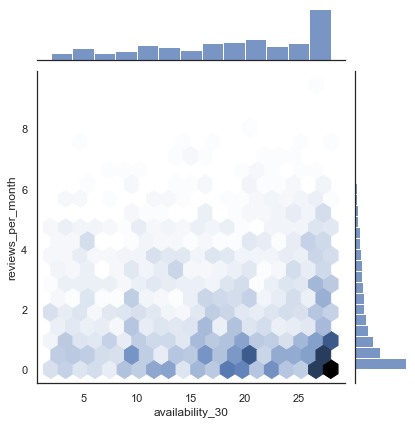

In [1324]:
data = df_y 
sns.jointplot(data = data, kind = 'hex', x = 'availability_30', y = 'reviews_per_month')

517


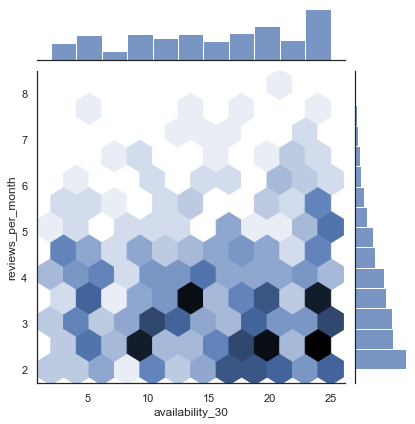

In [1325]:
data['availability_30'].loc[(data['availability_30'] > 25)] = np.NaN 
data = data[data['reviews_per_month'] > 2].dropna()
print(len(data))
sns.jointplot(data = data, kind = 'hex', x = 'availability_30', y = 'reviews_per_month')

# vs host_since

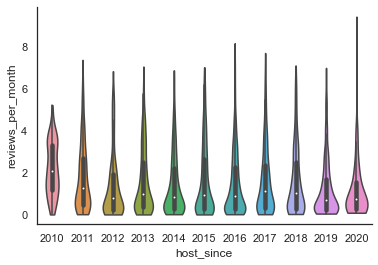

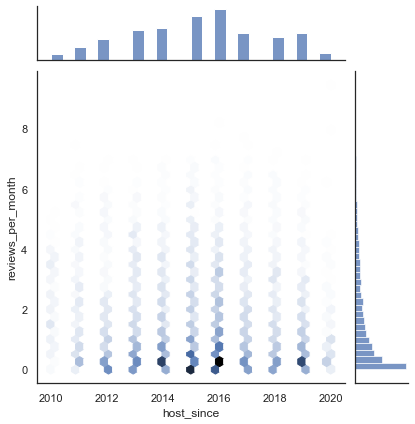

In [1326]:
data = df_y.join(df_x['host_since'])

sns.violinplot(x = data['host_since'].dropna().astype(int), y = 'reviews_per_month', data = data, cut = 0)
sns.despine()
sns.jointplot(x = 'host_since', y = 'reviews_per_month', data = data, kind = 'hex')
sns.despine()

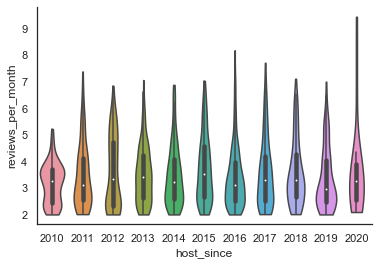

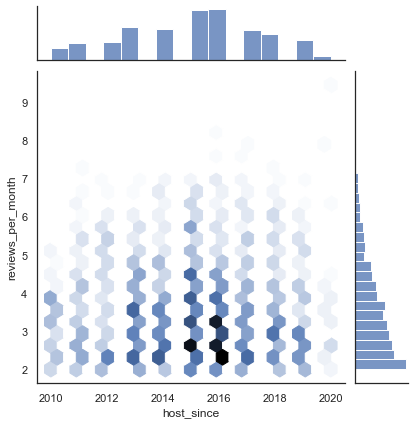

In [1327]:
data_f = data[data['reviews_per_month'] > 2]
sns.violinplot(x = data_f['host_since'].dropna().astype(int), y = 'reviews_per_month', data = data_f, cut = 0)
sns.despine()
sns.jointplot(x = 'host_since', y = 'reviews_per_month', data = data_f, kind = 'hex')
sns.despine()

<AxesSubplot:xlabel='host_since', ylabel='reviews_per_month'>

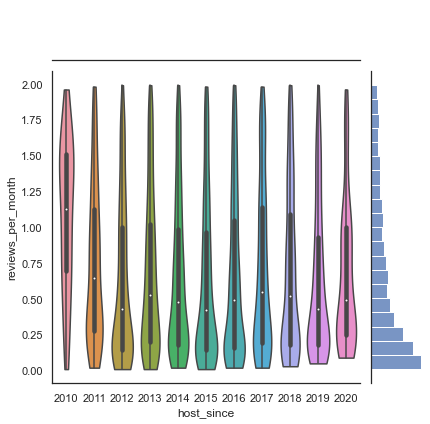

In [1332]:
data_f = data[data['reviews_per_month'] < 2]
sns.jointplot(x = 'host_since', y = 'reviews_per_month', data = data_f, kind = 'hex')
sns.violinplot(x = data['host_since'].dropna().astype(int), y = 'reviews_per_month', data = data_f, cut = 0)

In [1339]:
data_f[data_f['host_since'] == 2020].describe()
#data_f.describe()

,reviews_per_month,availability_30,host_since
count,138.000000,21.000000,138.0
mean,0.656594,16.952381,2020.0
std,0.500759,6.734064,0.0
min,0.090000,3.000000,2020.0
25%,0.250000,16.000000,2020.0
50%,0.495000,20.000000,2020.0
75%,1.000000,21.000000,2020.0
max,1.960000,25.000000,2020.0


# vs 'host_response_time','host_response_rate','host_acceptance_rate'

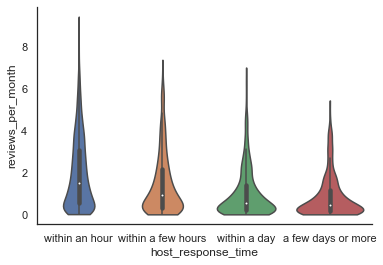

In [1340]:
data = df_y['reviews_per_month'].to_frame().join(df_x['host_response_time'])
order = ['within an hour', 'within a few hours', 'within a day', 'a few days or more']
sns.violinplot(x = 'host_response_time', y = 'reviews_per_month', data = data, cut = 0, order = order)
sns.despine()

In [873]:
data = df_x[['host_response_rate','host_acceptance_rate']].join(df_y['reviews_per_month'])

,host_response_rate,host_acceptance_rate,reviews_per_month
0,100.0,98.0,0.16
1,100.0,98.0,0.92
2,100.0,100.0,2.86
3,100.0,100.0,3.71
4,100.0,99.0,3.26
...,...,...,...
7993,NaN,NaN,NaN
7994,NaN,100.0,NaN
7995,100.0,100.0,NaN
7996,NaN,NaN,NaN


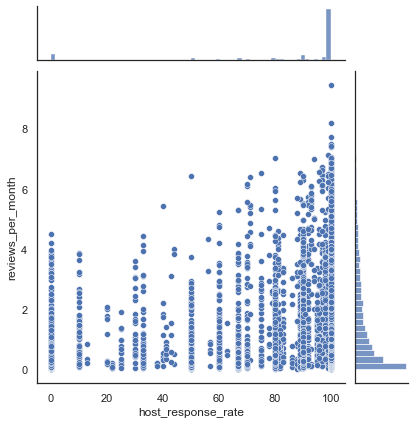

In [1342]:
data = df_x[['host_response_rate','host_acceptance_rate']].join(df_y['reviews_per_month'])
sns.jointplot(data = data, x = 'host_response_rate', y = 'reviews_per_month', kind = 'scatter')
sns.despine()

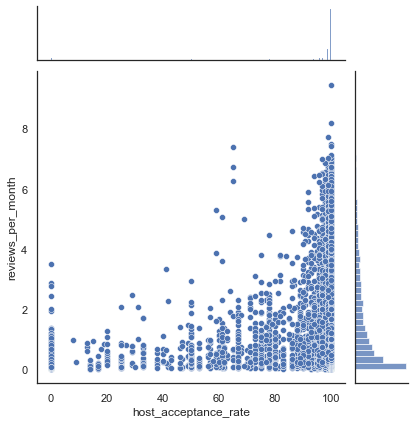

In [1343]:
data = df_x[['host_response_rate','host_acceptance_rate']].join(df_y['reviews_per_month'])
sns.jointplot(data = data, x = 'host_acceptance_rate', y = 'reviews_per_month', kind = 'scatter')
sns.despine()

# vs 'latitude','longitude'

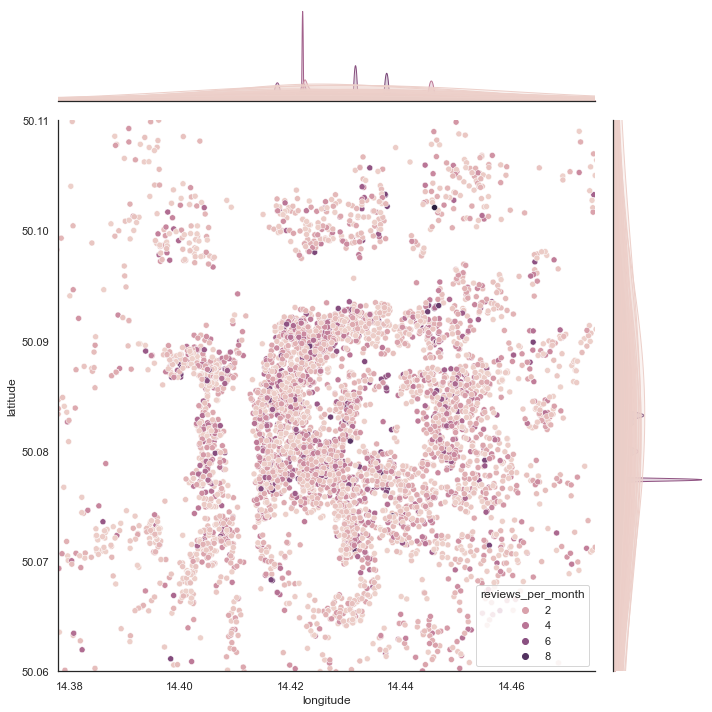

In [1344]:
data = df_x[['latitude','longitude']]
data = df_y['reviews_per_month'].to_frame().join(data)
sns.jointplot(data = data, x = 'longitude', y = 'latitude', hue = 'reviews_per_month', ylim = (50.06,50.11), xlim = (14.378,14.475), height = 10,dropna = True)

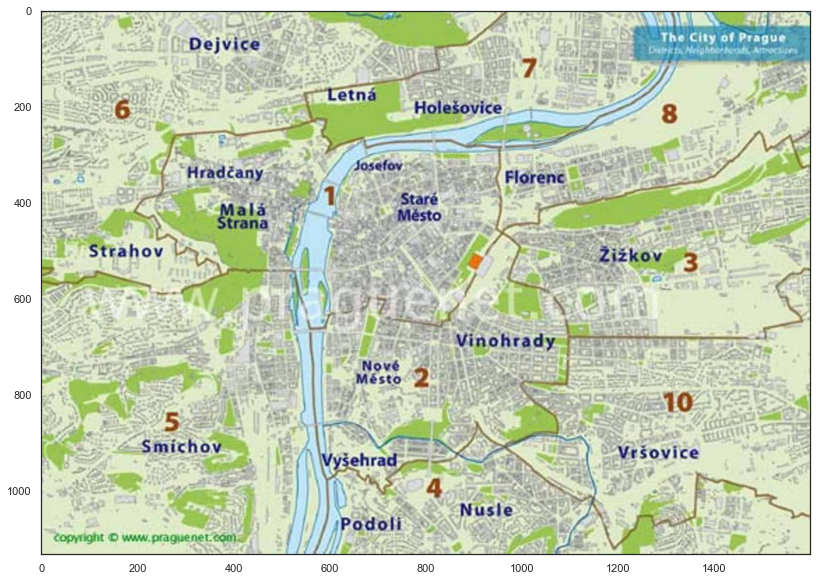

In [1345]:
show_pict('https://bezviz.info/images/czech/life/prague-districts.jpg')

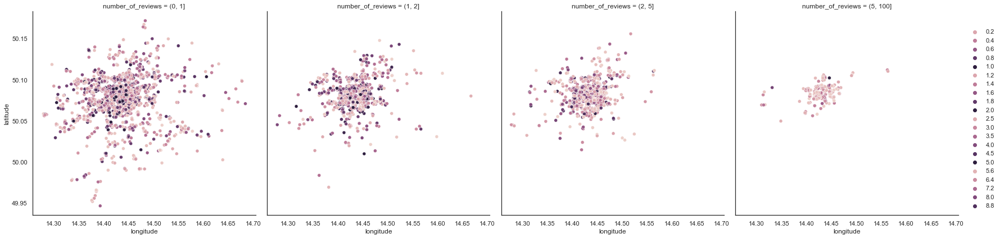

In [1350]:
data = df_x[['latitude','longitude']]
data = df_y['reviews_per_month'].to_frame().join(data)
data['number_of_reviews'] = pd.cut(data['reviews_per_month'],bins = (0,1,2,5,100))

g = sns.FacetGrid(data, col="number_of_reviews",sharex = True, sharey = True, height = 6)
g.map_dataframe(sns.scatterplot,'longitude','latitude',hue = 'reviews_per_month')
g.add_legend()

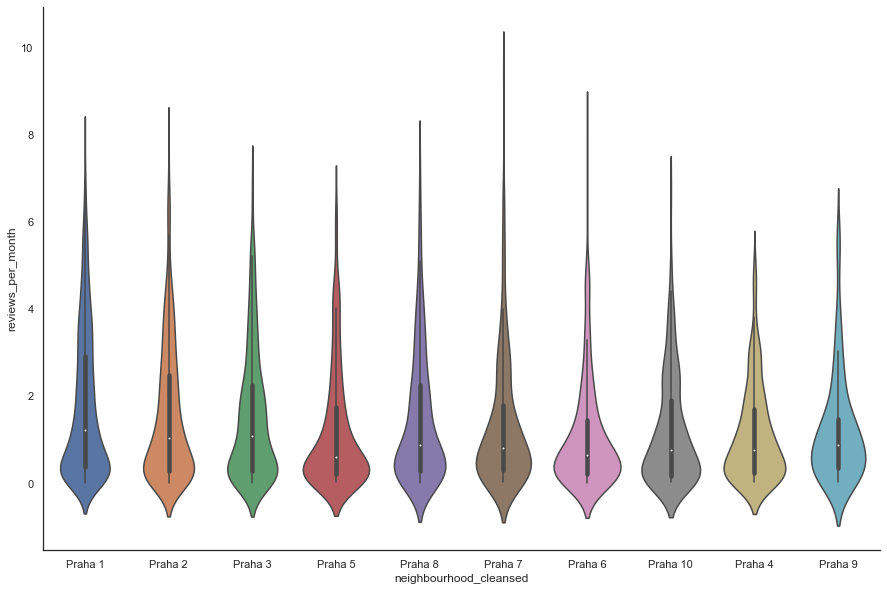

In [1351]:
data = df_x['neighbourhood_cleansed']
data = df_y['reviews_per_month'].to_frame().join(data)
order = data.groupby('neighbourhood_cleansed').count().sort_values(by = 'reviews_per_month', ascending = False).head(10).index
fig = plt.figure(figsize = (15,10))
sns.violinplot(data = data, x = 'neighbourhood_cleansed', y = 'reviews_per_month', order = order)
sns.despine()

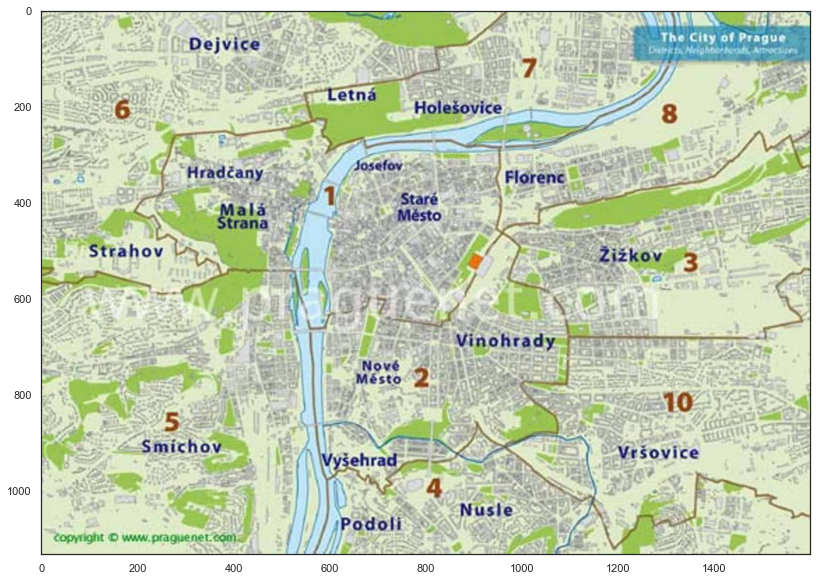

In [1352]:
show_pict('https://bezviz.info/images/czech/life/prague-districts.jpg')

In [1355]:
data = df_x[['neighbourhood_cleansed','price_EUR']]
data = df_y['reviews_per_month'].to_frame().join(data)
data.groupby('neighbourhood_cleansed').agg({'reviews_per_month':('mean','count'),'price_EUR':'mean'}).sort_values(by = ('reviews_per_month','count'), ascending = False).head(10).round(2)

reviews_per_month       price_EUR
                                    mean count      mean
neighbourhood_cleansed                                  
Praha 1                             1.79  2379    167.07
Praha 2                             1.58  1036    244.40
Praha 3                             1.53   809    142.67
Praha 5                             1.20   590    101.65
Praha 8                             1.47   417    108.68
Praha 7                             1.34   319    128.28
Praha 6                             1.08   294     63.93
Praha 10                            1.18   270     84.63
Praha 4                             1.13   257     71.50
Praha 9                             1.22    92     58.30

# vs price

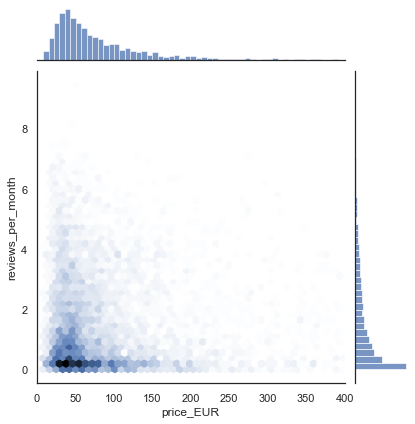

<AxesSubplot:xlabel='price_EUR', ylabel='reviews_per_month'>

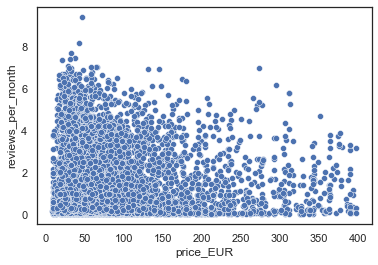

In [1356]:
data = df_y.join(df_x['price_EUR'][df_x['price_EUR']<400])
sns.jointplot(x = 'price_EUR', y = 'reviews_per_month', data = data, kind = 'hex', xlim = (0,400), dropna = True)
plt.show()
sns.scatterplot(x = 'price_EUR', y = 'reviews_per_month', data = data)

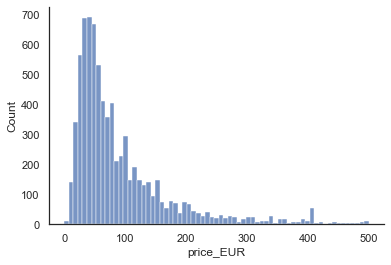

In [1357]:
sns.histplot(df_x['price_EUR'], binrange = (0,500))
sns.despine()

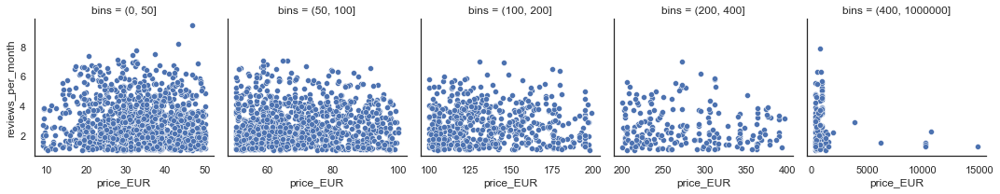

In [1358]:
data = df_x['price_EUR'].to_frame()
data['bins'] = pd.cut(data['price_EUR'],bins = (0,50,100,200,400,1000000))
data = data.join(df_y)
data = data[data['reviews_per_month']>1]
g = sns.FacetGrid(data, col="bins",sharex = False)
g.map(sns.scatterplot,'price_EUR','reviews_per_month')

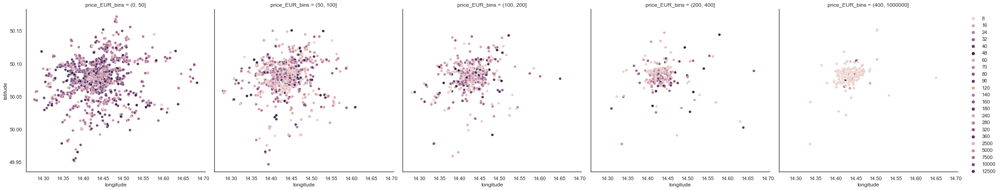

In [1361]:
data = df_x[['latitude','longitude','price_EUR']]
data['price_EUR_bins'] = pd.cut(data['price_EUR'],bins = (0,50,100,200,400,1000000))
data = data.join(df_y)
#data = data[data['reviews_per_month']>1]
g = sns.FacetGrid(data, col="price_EUR_bins",height = 6)
g.map_dataframe(sns.scatterplot,'longitude','latitude',hue = 'price_EUR')
g.add_legend()

In [1366]:
data = df_x[['price_EUR','neighbourhood_cleansed']].sort_values(by = 'price_EUR', ascending = False).join(df_y['availability_30']).dropna().head(10)

#data = data[(data['availability_30']>1)&(data['availability_30']<28)].
data

,price_EUR,neighbourhood_cleansed,availability_30
5136,1361.100,Praha 2,24.0
6141,1207.986,Praha 1,16.0
3713,1100.229,Praha 3,9.0
3671,921.414,Praha 3,9.0
4003,914.472,Praha 3,9.0
6352,858.000,Praha 1,13.0
5387,823.524,Praha 1,24.0
3473,780.000,Praha 2,23.0
3704,771.030,Praha 3,10.0
3708,756.561,Praha 3,9.0


Имя хоста Ancap


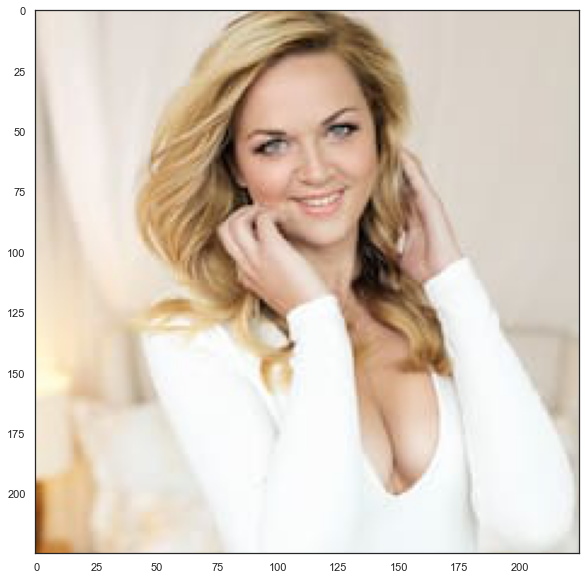

Цена в EUR за ночь 1361.1
https://www.airbnb.com/rooms/31928957


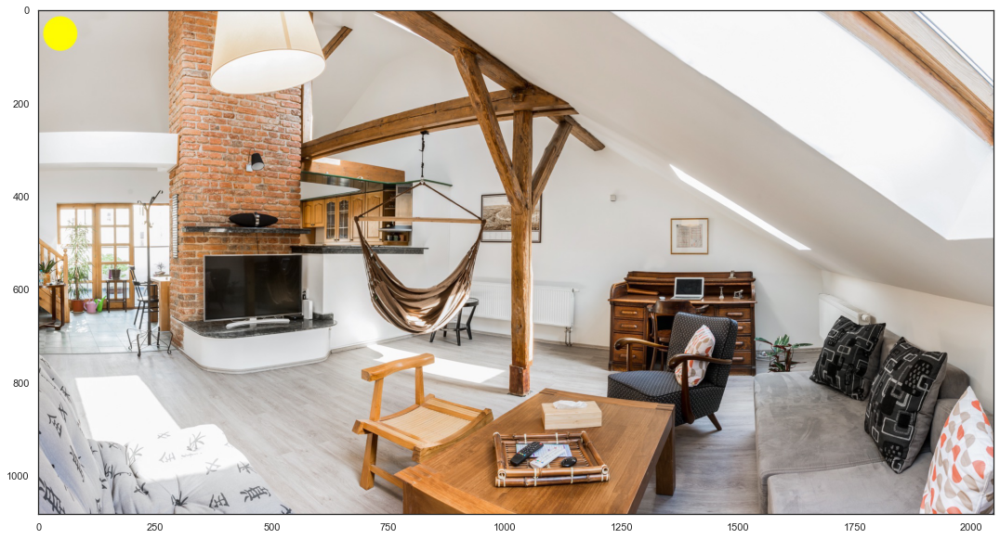

Имя хоста Morad


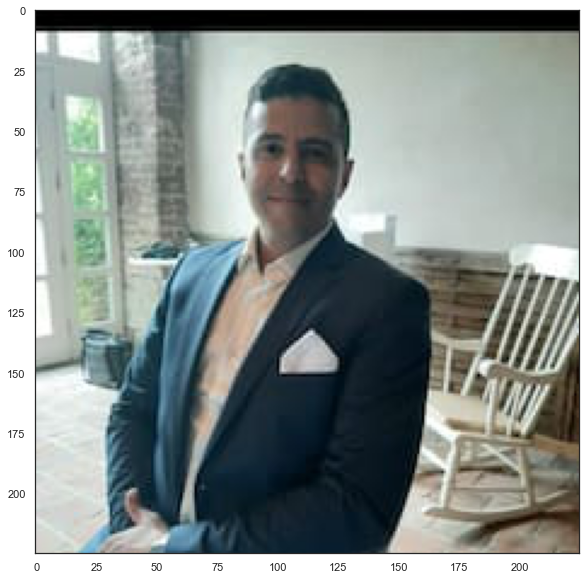

Цена в EUR за ночь 1207.986
https://www.airbnb.com/rooms/38146121


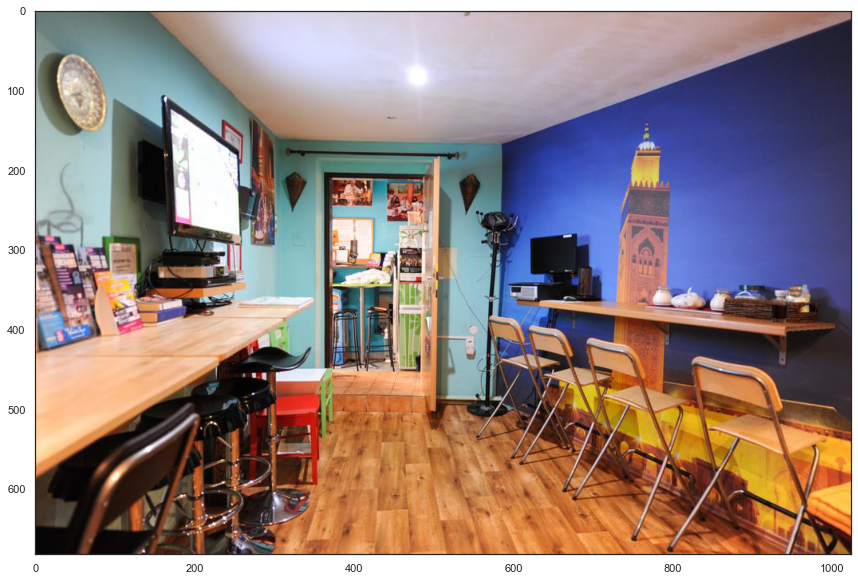

Имя хоста Prague For You


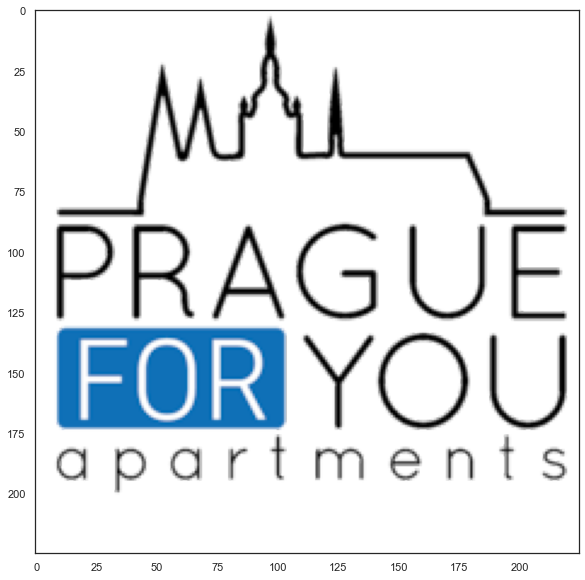

Цена в EUR за ночь 1100.229
https://www.airbnb.com/rooms/22368030


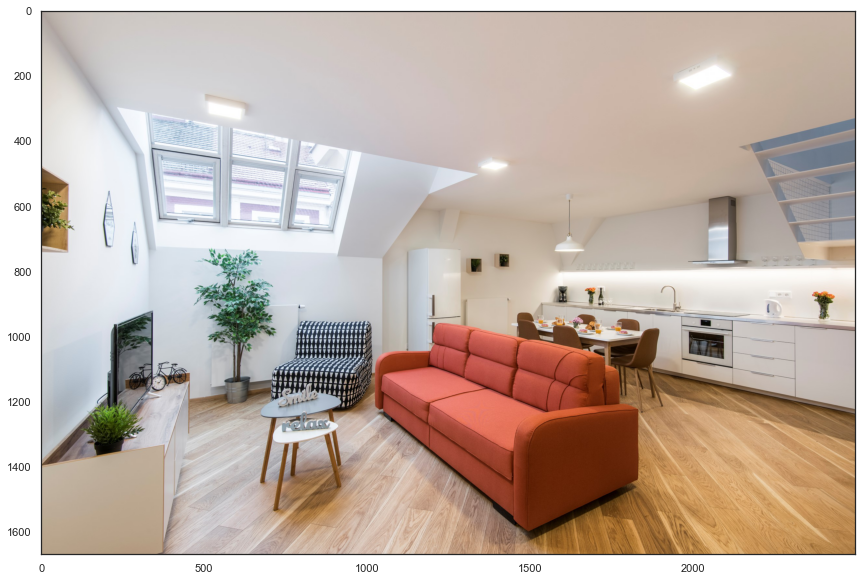

Имя хоста Prague For You


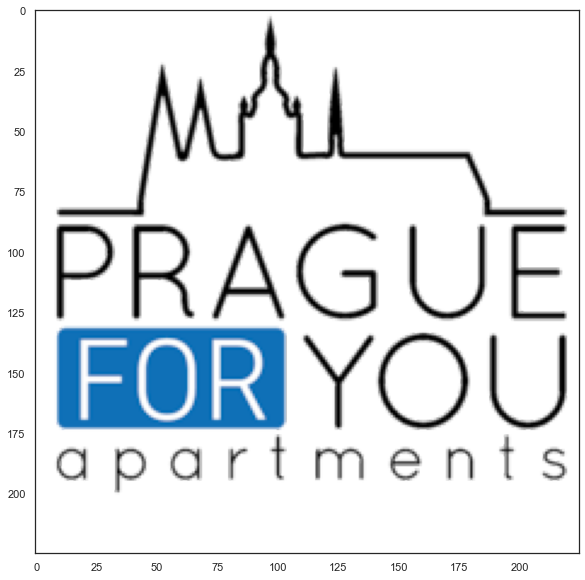

Цена в EUR за ночь 921.414
https://www.airbnb.com/rooms/22273845


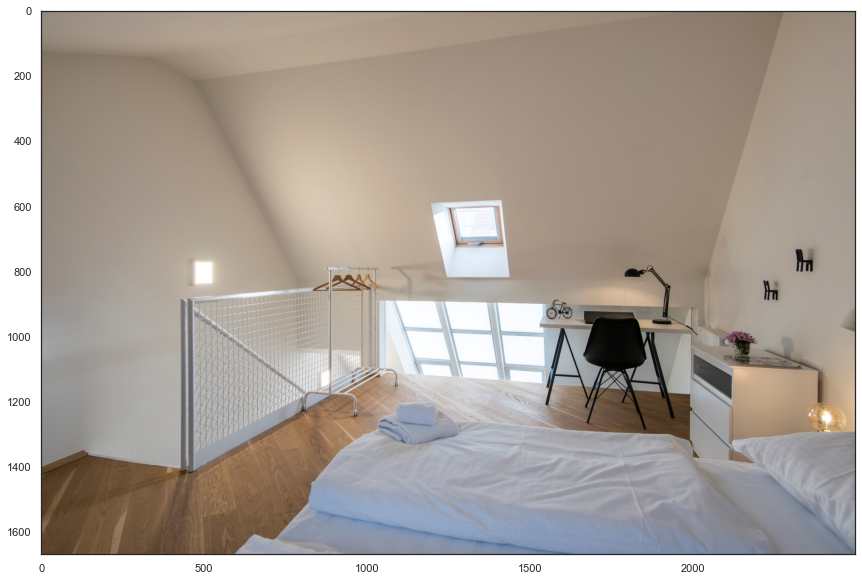

Имя хоста Prague For You


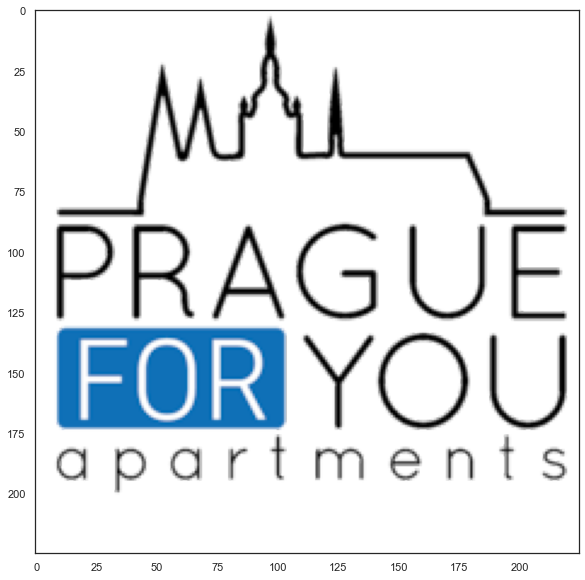

Цена в EUR за ночь 914.472
https://www.airbnb.com/rooms/24215082


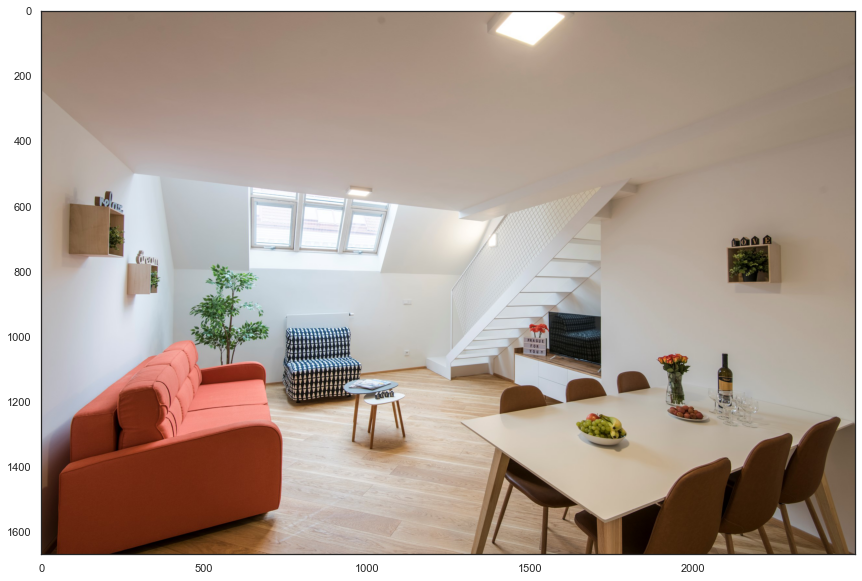

Имя хоста Lucy & Martin


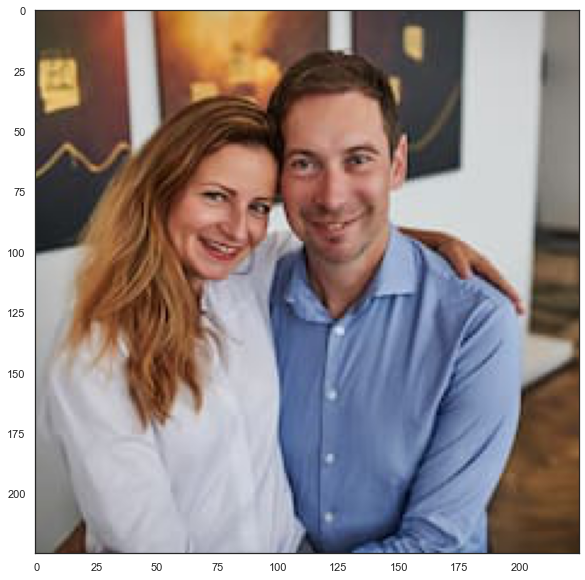

Цена в EUR за ночь 858.0
https://www.airbnb.com/rooms/39273335


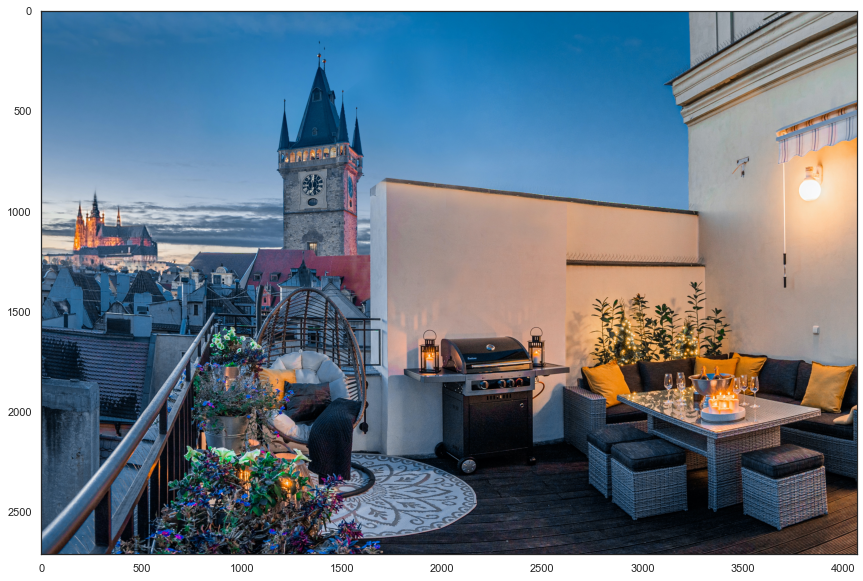

Имя хоста Residence


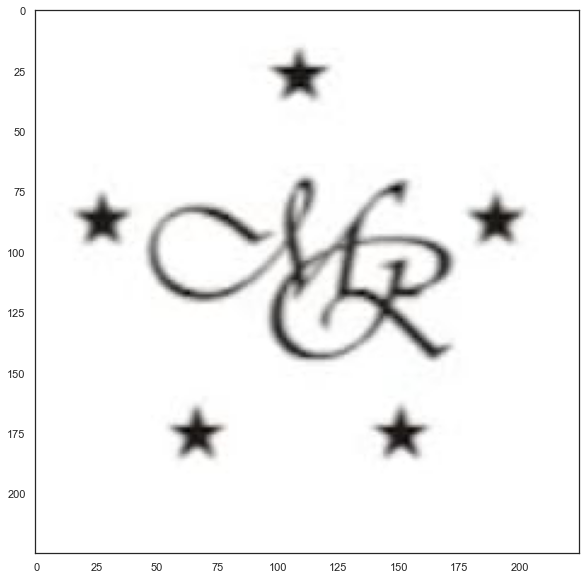

Цена в EUR за ночь 823.524
https://www.airbnb.com/rooms/33550185


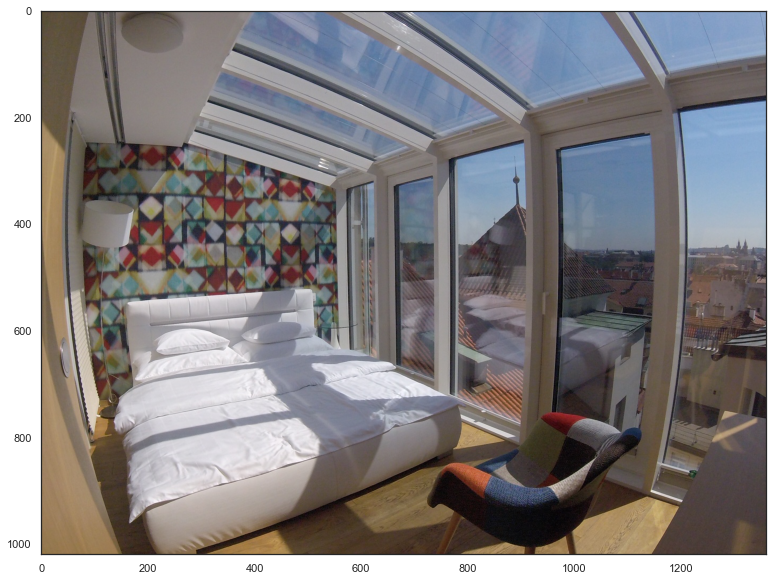

Имя хоста Jan


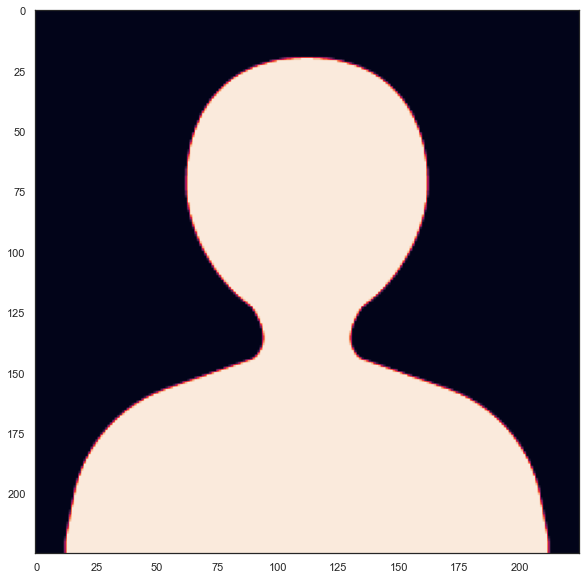

Цена в EUR за ночь 780.0
https://www.airbnb.com/rooms/21628827


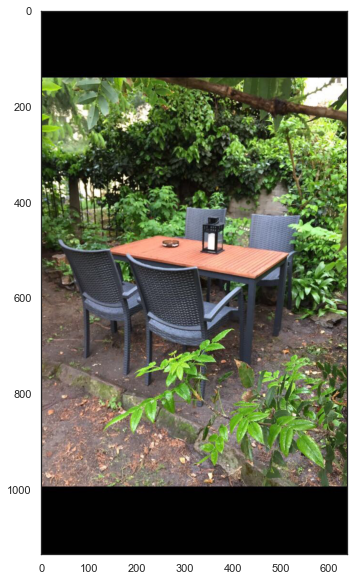

Имя хоста Prague For You


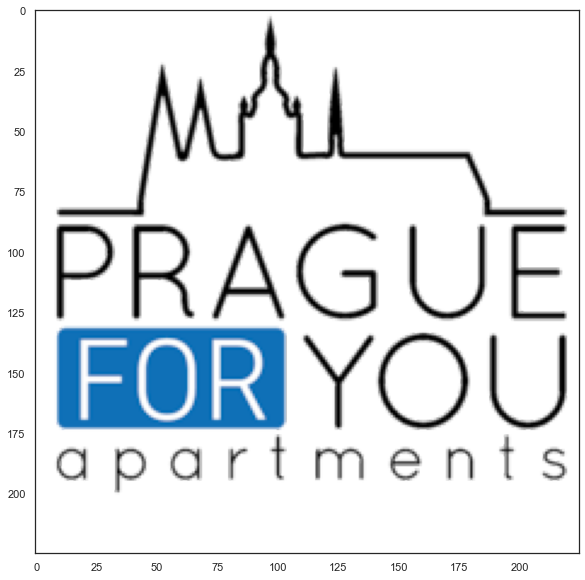

Цена в EUR за ночь 771.03
https://www.airbnb.com/rooms/22348573


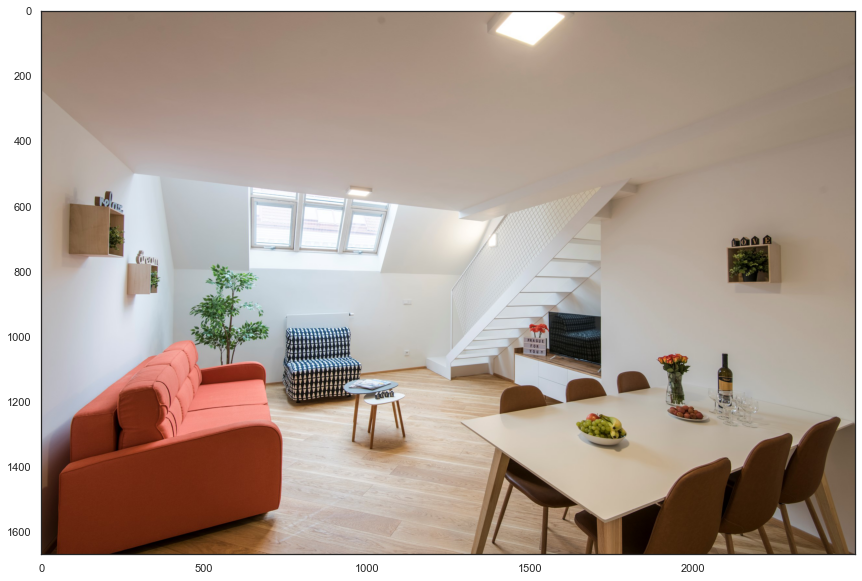

Имя хоста Prague For You


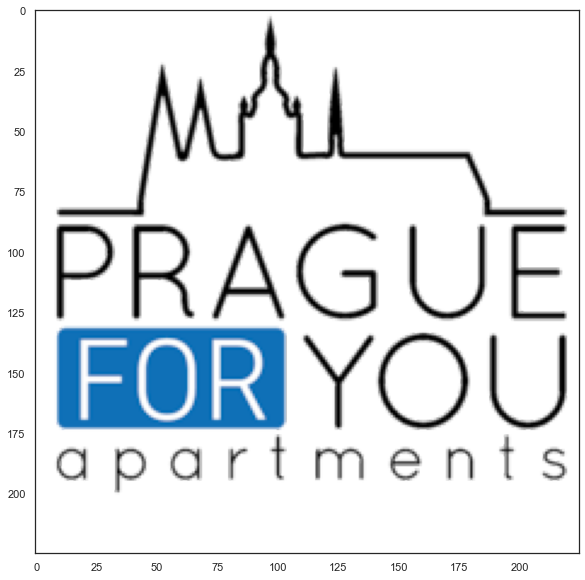

Цена в EUR за ночь 756.561
https://www.airbnb.com/rooms/22352230


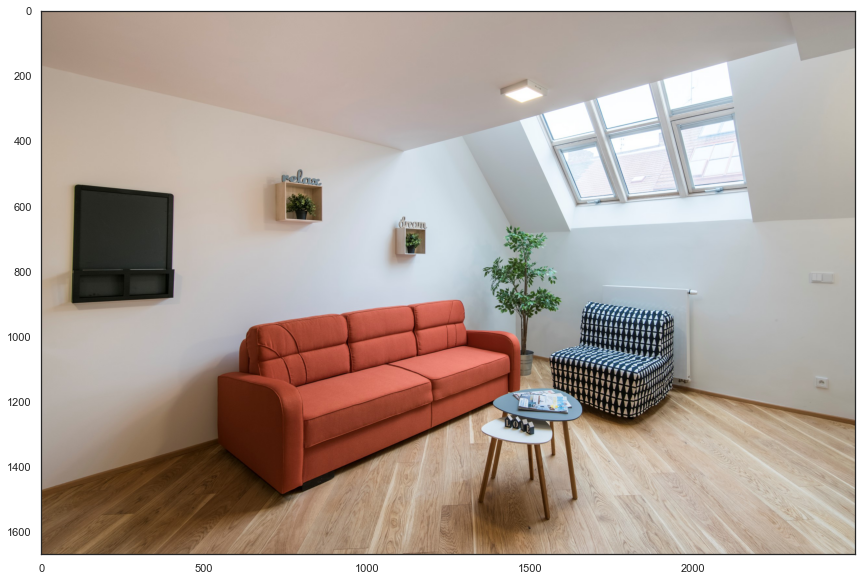

In [1367]:
for i,j in df.reindex(data.index).iterrows():    
    print('Имя хоста ' + str(df.loc[i]['host_name']))
    show_pict(df.loc[i]['host_picture_url'])
    print('Цена в EUR за ночь '+str(df_x.loc[i]['price_EUR']))
    print(df.loc[i]['listing_url'])
    show_pict(df.loc[i]['picture_url'])


# vs 'review_scores_rating'

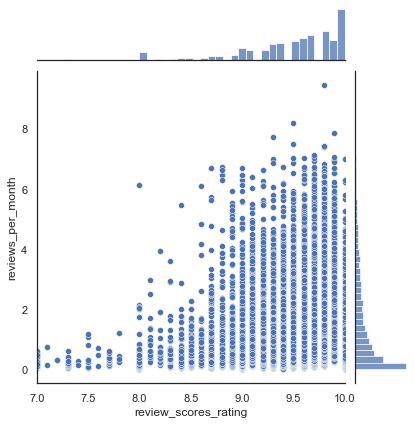

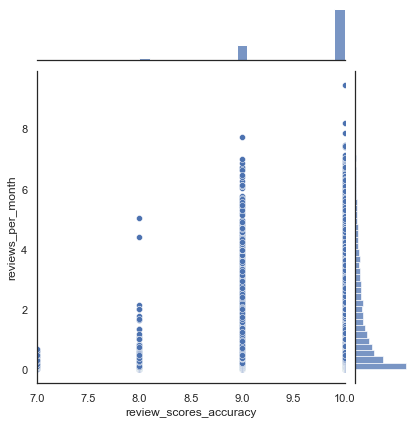

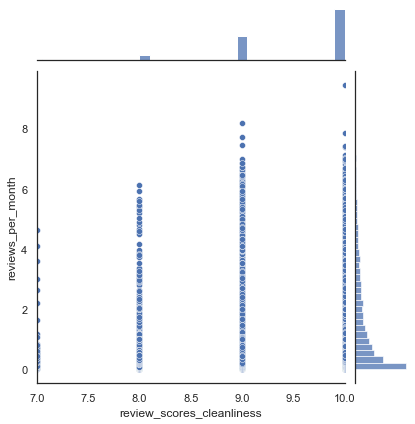

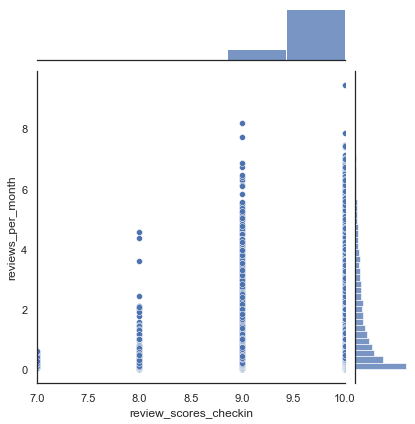

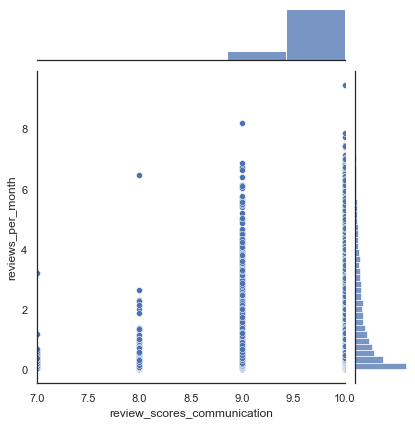

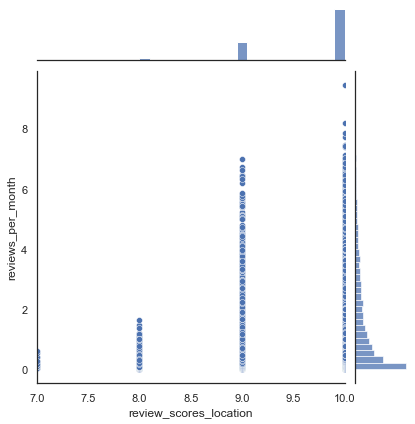

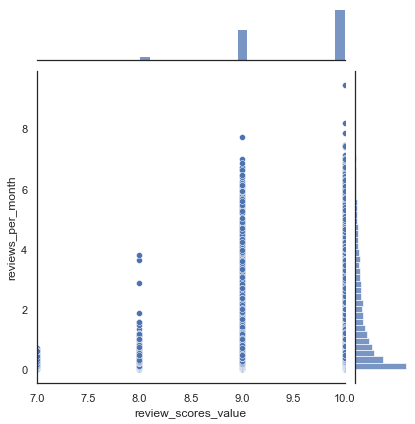

In [1370]:
data = df_x[['review_scores_rating','review_scores_accuracy','review_scores_cleanliness','review_scores_checkin','review_scores_communication','review_scores_location','review_scores_value']].join(df_y['reviews_per_month'])

for i in data.columns[:-1]:
    sns.jointplot(data = data, x = i, y = 'reviews_per_month', kind = 'scatter', xlim = (7,10))

# vs 'host_is_superhost', 'host_listings_count',
  #     'host_total_listings_count' - последние два поля одинаковы

<AxesSubplot:xlabel='host_is_superhost', ylabel='reviews_per_month'>

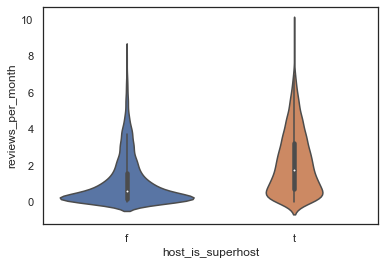

In [1372]:
data = df_x[['host_is_superhost', 'host_listings_count','host_total_listings_count']].join(df_y['reviews_per_month'])
sns.violinplot(data = data, x = 'host_is_superhost', y = 'reviews_per_month')
#sns.violinplot(data = data, x = 'host_listings_count', y = 'reviews_per_month')

<AxesSubplot:xlabel='host_total_listings_count', ylabel='Count'>

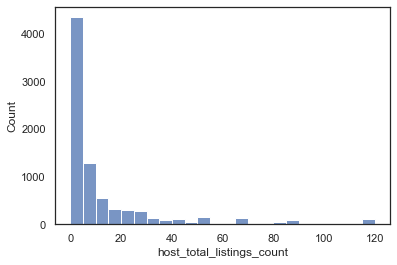

In [1373]:
sns.histplot(data = data['host_total_listings_count'], binwidth = 5)

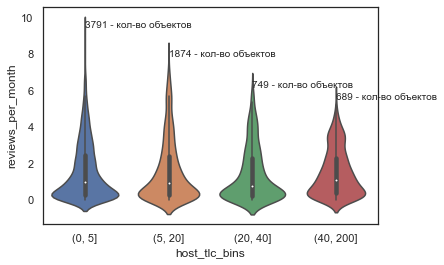

In [1374]:
data['host_tlc_bins'] = pd.cut(data['host_total_listings_count'], bins = (0,5,20,40,200))

ax = sns.violinplot(data = data, x = 'host_tlc_bins', y = 'reviews_per_month')
counts = data['host_tlc_bins'].value_counts()
n = 0
for i in data['host_tlc_bins'].unique().dropna().sort_values():
    max = data[data['host_tlc_bins'] == i]['reviews_per_month'].max()
    ax.annotate(str(counts.loc[i])+' - кол-во объектов',(n,max))
    n += 1

# vs 'room_type',
# 'accommodates',
# 'bathrooms_text',
# 'beds',
# 'bedrooms'

<AxesSubplot:xlabel='room_type', ylabel='reviews_per_month'>

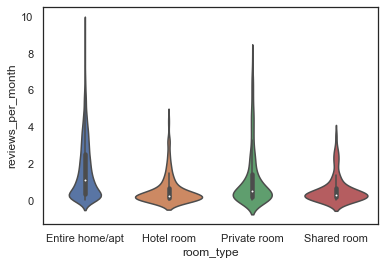

In [1375]:
data = df_x[['room_type','accommodates','bathrooms_text','beds','bedrooms']].join(df_y['reviews_per_month'])
sns.violinplot(data = data, x = 'room_type', y = 'reviews_per_month')

<AxesSubplot:xlabel='bathrooms_text', ylabel='reviews_per_month'>

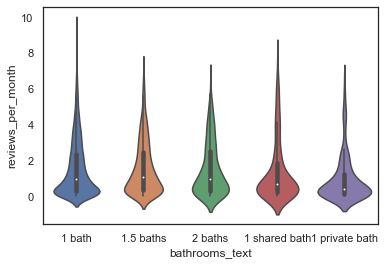

In [1376]:
order = df_x['bathrooms_text'].value_counts()[:5].index
sns.violinplot(data = data, x = 'bathrooms_text', y = 'reviews_per_month', order = order )

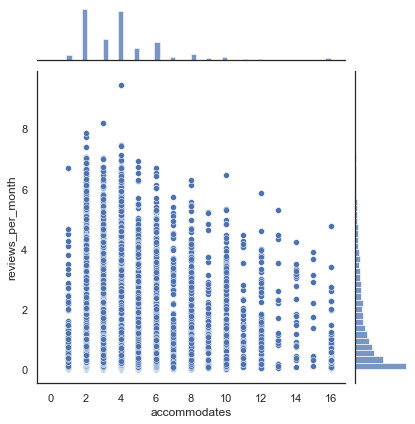

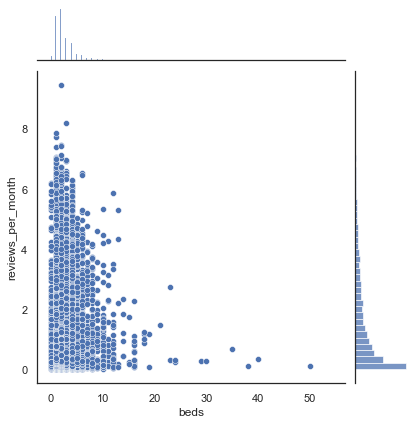

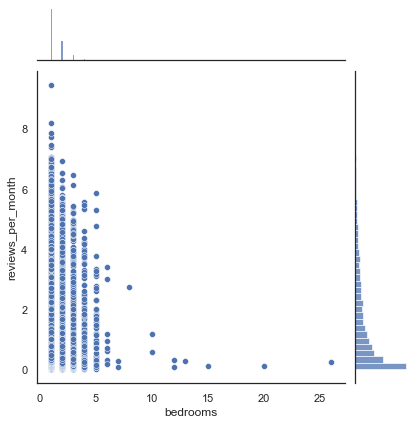

In [1377]:
for c in data[['accommodates','beds','bedrooms','reviews_per_month']].columns[:-1]:
    sns.jointplot(data = data, x = c, y = 'reviews_per_month')

# vs 'instant_bookable'

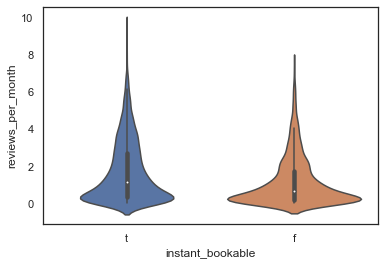

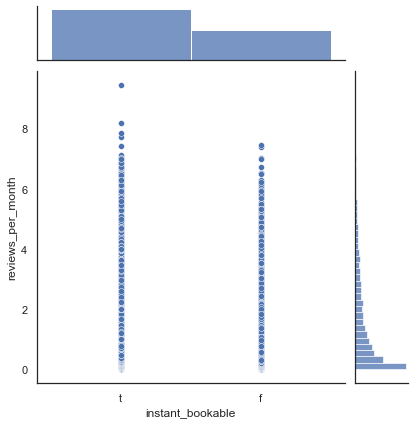

In [1378]:
data = df_x['instant_bookable'].to_frame().join(df_y['reviews_per_month'])

sns.violinplot(data = data, x = 'instant_bookable', y = 'reviews_per_month')
sns.jointplot(data = data, x = 'instant_bookable', y = 'reviews_per_month')
sns.despine()

# vs 'number_of_reviews_ltm'

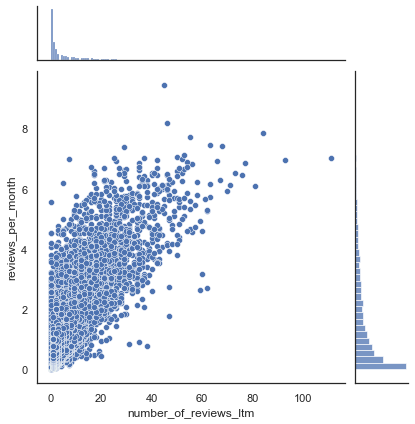

In [1379]:
data = df_x['number_of_reviews_ltm'].to_frame().join(df_y['reviews_per_month'])

sns.jointplot(data = data, x = 'number_of_reviews_ltm', y = 'reviews_per_month')
sns.despine()

In [1380]:
df_x_good = df_x[df_x['number_of_reviews_ltm']>20]

In [1381]:
df_x_good.describe()

,host_since,host_response_rate,host_acceptance_rate,host_listings_count,host_total_listings_count,latitude,longitude,accommodates,beds,bedrooms,number_of_reviews_ltm,review_scores_rating,review_scores_accuracy,review_scores_cleanliness,review_scores_checkin,review_scores_communication,review_scores_location,review_scores_value,price_EUR
count,732.000000,697.000000,720.000000,732.000000,732.000000,735.000000,735.000000,735.000000,735.000000,622.000000,735.000000,735.000000,709.000000,709.000000,709.000000,709.000000,709.000000,709.000000,735.000000
mean,2015.394809,96.375897,99.069444,15.613388,15.613388,50.083118,14.427455,4.240816,2.417687,1.503215,32.151020,9.588435,9.825106,9.603667,9.856135,9.888575,9.882934,9.747532,98.578204
std,2.500041,9.323028,2.992463,25.332686,25.332686,0.010019,0.023008,2.447368,1.933066,0.831635,11.167552,0.334183,0.387505,0.579341,0.366935,0.332338,0.321726,0.437972,146.696434
min,2010.000000,0.000000,59.000000,0.000000,0.000000,50.023720,14.313120,1.000000,0.000000,1.000000,21.000000,8.000000,8.000000,7.000000,8.000000,7.000000,9.000000,8.000000,9.360000
25%,2013.000000,98.000000,99.000000,2.000000,2.000000,50.077960,14.418040,2.000000,1.000000,1.000000,24.000000,9.400000,10.000000,9.000000,10.000000,10.000000,10.000000,9.000000,34.651500
50%,2015.000000,100.000000,100.000000,6.000000,6.000000,50.082550,14.425460,4.000000,2.000000,1.000000,29.000000,9.700000,10.000000,10.000000,10.000000,10.000000,10.000000,10.000000,56.940000
75%,2017.000000,100.000000,100.000000,14.000000,14.000000,50.088760,14.437580,5.000000,3.000000,2.000000,36.000000,9.800000,10.000000,10.000000,10.000000,10.000000,10.000000,10.000000,102.648000
max,2020.000000,100.000000,100.000000,117.000000,117.000000,50.155760,14.563610,16.000000,23.000000,8.000000,111.000000,10.000000,10.000000,10.000000,10.000000,10.000000,10.000000,10.000000,1452.711000
